<a href="https://colab.research.google.com/github/vilcagamarracf/Python_Snippets/blob/main/Snippets/Snippets_GEE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GEE Snippets - Colaboratory 👨‍🚀




## Inicio

#### Referencias

<center>
<!-- <h2> GEE Snippets - Colaboratory 👨‍🚀</h2> -->
<p>
<br>
<img src="https://www.gislounge.com/wp-content/uploads/2018/06/google-earth-engine.jpg"height="200px" hspace="10px" vspace="0px">
<img src='https://camo.githubusercontent.com/ddb523e409d38bf47f0b1949e122dbed850fcf67ae6a9cd76a2157b28526befc/68747470733a2f2f7261772e6769746875622e636f6d2f676f6f676c652f6561727468656e67696e652d6170692f6d61737465722f7472656e64792d6c69676874732e706e67' height="200px">
</p>
</center>

**Links de importancia**

- [GitHub: Google Earth Engine API](https://github.com/google/earthengine-api) : Repositorio de Earth Engine: versión actual, ejemplos, issues y más.
- [GEE - The Client Libraries section](https://developers.google.com/earth-engine/apidocs) : Lista completa de funciones (API reference for both JavaScript and Python clients)

**Referencias de apoyo**
- [Cesar Vilca - Google Earth Engine: Breve Introducción](https://vilcagamarracf.github.io/blog/blog_earthengine.html) : Aquí reuno información sobre la plataforma.
- [Earth Engine Python API Colab Setup - Jupyter Notebook](https://colab.research.google.com/github/google/earthengine-api/blob/master/python/examples/ipynb/ee-api-colab-setup.ipynb) : Ejemplo base para comenzar a usar Earth Engine con Python en Colab.
- [GEE - Python Installation](https://developers.google.com/earth-engine/guides/python_install) : Earth Engine con Python: sintaxis, características, diferencias con Javascript y más. 
- [Gis&Beers: Recopilatorio de scripts para Google Earth Engine](http://www.gisandbeers.com/scripts-para-google-earth-engine/)
  - [Simbología de rampas de color para Google Earth Engine](http://www.gisandbeers.com/simbologia-rampas-color-google-earth-engine/)
  - [Colección de paletas de color para Google Earth Engine](http://www.gisandbeers.com/coleccion-paletas-de-color-google-earth-engine/)
  - [Incorporación de leyenda en Google Earth Engine](http://www.gisandbeers.com/incorporacion-leyenda-en-google-earth-engine/)
 - [Análisis de vegetación NDVI multitemporal en Google Earth Engine](http://www.gisandbeers.com/analisis-de-vegetacion-ndvi-multitemporal-google-earth-engine/)
- [Foro StackExchange: Búsqueda de dudas/Issues de GEE](https://gis.stackexchange.com/questions/tagged/google-earth-engine)
- [Philipp Gärtner Blog: Collection of Google Earth Engine management tips](https://philippgaertner.github.io/2019/05/gee-management-tips/)

**Repositorios en GitHub**
- [Hannah Kerner: gee tutorials in GitHub](https://github.com/hannah-rae/gee_tutorials): Tutorials for Google Earth Engine using the Python API
- [bertcoerver en GitHub](https://github.com/bertcoerver/geegis/blob/master/geegis.py)

#### Google Earth Engine en Colab: Iniciandose en Colab y Python

Instalar/Actualizar `earthengine-api`

In [ ]:
# !pip install earthengine-api 
# !pip install earthengine-api --upgrade 

Revisar la versión actual de Google Earth Engine API: Versión actual instalada

In [ ]:
# import ee
print(f'GEE Actual Version: {ee.__version__}')

Más de `!pip`:
- [How do I update a python package?](https://stackoverflow.com/questions/5183672/how-do-i-update-a-python-package)
- [Understand Python import, module, and package](https://medium.com/python-in-plain-english/understand-python-import-module-and-package-c5b4289bbf60) 

In [ ]:
# Listar librerías
!pip list

In [ ]:
# Versiones desfasadas
!pip list --outdated

Login simple de EE en Colab

In [ ]:
import ee
ee.Authenticate()
ee.Initialize()

#### Google Earth Engine en Colab: Manos a la obra!



1. Ingresar con nuestra cuenta de Google Earth Engine e inicializar la librería `ee`

In [3]:
# # Ingresa tus credenciales de Google Earth Engine para comenzar
# import ee
# ee.Authenticate()

# # Inicio
# ee.Initialize()

# # Mensaje de login
# print('\nYa estás logeado.')
# print('GEE Version:', ee.__version__)

In [4]:
#@markdown *Credenciales Google Earth Engine: Forma rápida*
import os 
credential = '{"refresh_token":"1//09lhqedCNpNDsCgYIARAAGAkSNwF-L9IraEP8FyJma46WSiEHhOMsZqSoTPJsi3Lar0C4nZUwj2QCZ_i66-McVzy4NmMalQL17KM"}'
credential_file_path = os.path.expanduser("~/.config/earthengine/")
os.makedirs(credential_file_path,exist_ok=True)
with open(credential_file_path + 'credentials', 'w') as file:
    file.write(credential)
import ee
ee.Initialize()
print('Ya estás logeado.')
print('GEE Version:',ee.__version__)

Ya estás logeado.
GEE Version: 0.1.290


2. Instalar `geemap` para visualizaciones e importar

In [5]:
%%capture
!pip install -U geemap

In [6]:
import geemap
Map = geemap.Map(basemap = 'ESRI', layer_ctrl=True)
Map

Map(center=[20, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=HBox(children=(Togg…

4. Importar librerías, funciones y más:


In [7]:
# @markdown - `mapdisplay`: Variable global: `mapViz`
# @markdown - `ee_get_dates`
# @markdown - `conv_fecha`
# @markdown - `ver_rangos`
# @markdown - `create_dateranges`

# mapdisplay
import folium 
def mapdisplay(center, dicc, Tiles="OpensTreetMap",zoom_start=10):
    '''
    Crea mapas interactivos usando la librería `folium`

    - `center`: Center of the map (Latitude and Longitude) (`list`)
    - `dicc`: Earth Engine Geometries or Tiles dictionary (`dict`)
    - `Tiles=`: 
    Mapbox Bright 
    Mapbox Control Room
    Stamen Terrain
    Stamen Toner
    stamenwatercolor
    cartodbpositron
    - `zoom_start=`: Initial zoom level for the map (`int`)

    Return: A folium.Map object
    '''
    # Centrado de imagen (El [::-1] lee inversamente la lista)
    center = center[::-1]

    # Agregando parámetros de visualización
    global mapViz
    mapViz = folium.Map(location=center,tiles=Tiles, zoom_start=zoom_start, control_scale=True)

    # Seteando la visualización de Images
    for k,v in dicc.items():
      if ee.image.Image in [type(x) for x in v.values()]:
        folium.TileLayer(tiles = v["tile_fetcher"].url_format,
                         attr  = 'Google Earth Engine',
                         overlay =True,
                         name  = k).add_to(mapViz)
      else:
        folium.GeoJson(data = v,
                       name = k).add_to(mapViz)
    # Agregar: Minimapa
    # from folium.plugins import MiniMap
    # minimap = MiniMap(
    #     tile_layer="OpensTreetMap", 
    #     position="bottomright", 
    #     zoom_level_fixed=4)
    # mapViz.add_child(minimap) # https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/MiniMap.ipynb

    # Fullscreen (no funciona en colab)
    # plugins.Fullscreen().add_to(mapViz)

    # Agregando el control de layers
    mapViz.add_child(folium.LayerControl())
    return mapViz
print('mapdisplay(center, dicc, Tiles="OpensTreetMap",zoom_start=10) listo!')


# ee_get_dates ----------------------------------------
from datetime import datetime as dt
def ee_get_dates(ic):
  """
  Permite obtener información de la Fecha y Hora de toma de imágen por el satélite.
  - ic: `ee.ImageCollection()`
  """
  dates = ic.aggregate_array('system:time_start').getInfo()
  anonym = lambda x: dt.utcfromtimestamp(x/1000).strftime('%Y-%m-%d %H:%M:%S')
  return list(map(anonym, dates))
# print('ee_get_dates(ic) listo!')

 
# conv_fecha ----------------------------------------
def conv_fecha(img, exact=None):
  '''
  Obtener fecha con formato YYYY-MM-dd H:mm:ss
  img: ee.Image
  '''
  if exact==True:
    return img.date().format('YYYY-MM-dd').getInfo()
  else:
    return img.date().format('YYYY-MM-dd H:mm:ss').getInfo()
# print('conv_fecha(img, getInfo=None) listo!')


# ver_rangos ----------------------------------------

Start_date = '2012-01-01'
End_date   = '2021-01-31'
range_date = [Start_date, End_date]

def ver_rangos(img_col, range_date= [Start_date, End_date]):
  """
  Devuelve los rangos de fechas existente en un rango inicial escrito manualmente como input.
  Pasos:
  1. `Reducer.minMax()` devuelve un valor min y max
  2. `icol.reduceColumns()` devuelve un diccionario con el min-max
  more info: https://developers.google.com/earth-engine/apidocs/ee-imagecollection-reducecolumns?hl=en
  """
  
  rango = img_col.reduceColumns(ee.Reducer.minMax(), ["system:time_start"]) # Retorna un ee.dictionary: {'max': 1608132402761, 'min': 1545060401000}

  # Obtención de la fecha min y max del image collection en formato ISO standard 8601
  # Javascript trabaja las fechas con milisegundos (se deja así)
  # Python     trabaja las fechas con segundos (por eso /1000)
  init_date = ee.Date(rango.get('min')).getInfo()['value']/1000.
  last_date = ee.Date(rango.get('max')).getInfo()['value']/1000.

  # Dar formato a las fechas  
  from datetime import datetime as dt
  init_date_f = dt.utcfromtimestamp(init_date).strftime('%Y-%m-%d') # %H:%M:%S
  last_date_f = dt.utcfromtimestamp(last_date).strftime('%Y-%m-%d') # %H:%M:%S
  
  # Obtenga el rango de fechas de las imágenes en la colección.
  range_date = [Start_date, End_date]
  print('Total imágenes: {}'.format(img_col.size().getInfo()))
  print('Rango Temporal Ingresado : {} - {}'.format(range_date[0], range_date[1]))
  print('Rango Temporal Real      : {} - {}'.format(init_date_f, last_date_f))
# print('ver_rangos(icol, range_date= [Start_date, End_date]) listo!')


# create_dateranges ----------------------------------------
def create_dateranges(init_date, time, range_1, range_2):
  '''
  init_date: '20XX' for monthly dates, '20XX-XX' for daily dates(string)
  time: 'year', 'month', 'day' (string)
  range_1: 1, ... 12 for monthly values (int)
  range_2: 1, ... 13 for monthly values (int)

  Returns a date ranges in a list form.
  '''
  ranges = []
  def create_dates(date, plus_time):
     ''' 
     init_date: string values only, example:  '2013-1'
     time: 'year', 'month', 'day'
  
     more info: https://developers.google.com/earth-engine/apidocs/ee-date-getrange
     '''
     var_time = ee.Date(date).getRange(plus_time).getInfo().get('dates')
  
     from datetime import datetime as dt #-%d
     Start_Date = dt.utcfromtimestamp(var_time[0]/1000).strftime('%Y-%m')
     End_Date   = dt.utcfromtimestamp(var_time[1]/1000).strftime('%Y-%m')
     return  [Start_Date, End_Date, i-1]
  
  for i in range(range_1, range_2+1):
    ranges.append(create_dates(init_date+'-'+str(i), time))
  return ranges
# print('create_dateranges(init_date, time, range_1, range_2) listo!')

mapdisplay(center, dicc, Tiles="OpensTreetMap",zoom_start=10) listo!


## Visualización de datos

#### Con [`folium`](https://python-visualization.github.io/folium/)

In [ ]:
# @markdown Función `mapdisplay`
import folium 
def mapdisplay(center, dicc, Tiles="OpensTreetMap",zoom_start=10):
    '''Crea mapas interactivos usando la librería `folium`

    - `center`: Center of the map (Latitude and Longitude) (`list`)
    - `dicc`: Earth Engine Geometries or Tiles dictionary (`dict`)
    - `Tiles=`: 
    Mapbox Bright 
    Mapbox Control Room
    Stamen Terrain
    Stamen Toner
    stamenwatercolor
    cartodbpositron
    - `zoom_start=`: Initial zoom level for the map (`int`)

    Return: A folium.Map object
    '''
    # Centrado de imagen (El [::-1] lee inversamente la lista)
    center = center[::-1]

    # Agregando parámetros de visualización
    global mapViz
    mapViz = folium.Map(location=center,tiles=Tiles, zoom_start=zoom_start, control_scale=True)

    # Seteando la visualización de Images
    for k,v in dicc.items():
      if ee.image.Image in [type(x) for x in v.values()]:
        folium.TileLayer(tiles = v["tile_fetcher"].url_format,
                         attr  = 'Google Earth Engine',
                         overlay =True,
                         name  = k).add_to(mapViz)
      else:
        folium.GeoJson(data = v,
                       name = k).add_to(mapViz)
    # Agregar: Minimapa
    from folium.plugins import MiniMap
    minimap = MiniMap(tile_layer="OpensTreetMap", position="bottomright")
    mapViz.add_child(minimap)

    # --- Fullscreen (no funciona en colab) ---
    # from folium.plugins import Fullscreen
    # Fullscreen().add_to(mapViz)

    # Agregando el control de layers
    mapViz.add_child(folium.LayerControl())
    return mapViz

print('mapdisplay(center, dicc, Tiles="OpensTreetMap", zoom_start=10) listo!')

mapdisplay(center, dicc, Tiles="OpensTreetMap",zoom_start=10) listo!


#### Con [`geemap`](https://geemap.org/notebooks/00_geemap_key_features/#create-an-interactive-map)

**Antes**: Las visualizaciones (estáticas e interactivas) en Colab serán usando librerías como **`folium`** y **`ipyleaflet`**. 

> A key difference between `folium` and `ipyleaflet` is that `ipyleaflet` is built upon `ipywidgets` and allows bidirectional communication between the front-end and the backend enabling the use of the map to capture user input, while folium is meant for displaying static data only (source). \
  **Note that Google Colab currently does not support ipyleaflet (source).**

**Ahora**: **September 2021 - geemap disponible en Colab**

Más info: 
- [GEE - Image Visualization](https://developers.google.com/earth-engine/guides/image_visualization#mapVisParamTable) : `geemap` se ha desarrollado buscando que el desarrollo en Python sea similar a con Javascript, por ello sus funciones presentan los mismos nombres a excepción de los argumentos que dichas funciones reciben.
- [GEE - third party libraries for UI elements in Python](https://developers.google.com/earth-engine/guides/python_install#ui-objects) : Conjunto de librerías de terceros para visualización.
- [Ejemplos de Folium](https://github.com/python-visualization/folium/tree/master/examples) : Para implementar más widgets a la visualización.
- **OJO**: Posibles actualizaciones de `ipyleafleat` pueden ser no compatibles con `geemap`, ocasionando bugs. 



In [ ]:
# Instalar geemap
%%capture
!pip install -U geemap

In [ ]:
# Visualizador interactivo
import geemap
Map = geemap.Map(basemap = 'ESRI', layer_ctrl=True)
Map

Map(center=[40, -100], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=HBox(children=(T…

## Manejo de Datos

### Archivos Vectoriales: `ee.FeatureCollection`

#### Lectura de ROI como `ee.FeatureCollection`

Para obtener áreas de interés (AOI o ROI) hay dos formas de lectura:
- Archivos GeoJSON: 
  1. Dibujar área de estudio de forma rápida: http://geojson.io/
  2. Copiar el código y asignarle una variable
  3. Agregar un constructor `ee.FeatureCollection(variable)`
  
- Archivos en Asset de GEE:
  1. Para más información sobre el manejo de archivos en el Asset de GEE: [Managing Assets](https://developers.google.com/earth-engine/guides/asset_manager)
  2. Copiar el ID del archivo de vuestro Asset y usar el constructor ee.FeatureCollection.

Finalmente, aplicar `.geometry()` a los ee.FeatureCollection para volverlos una geometría trabajable.

In [ ]:
# Assets personales con datos vectoriales del Instituto Geográfico Nacional (IGN)
# https://www.idep.gob.pe/#visor

# Departamentos del Perú
departamentos = ee.FeatureCollection('users/CesarVilca/departamentos')

# Provincias del Perú
provincias = ee.FeatureCollection('users/CesarVilca/provincias')

# Distritos del Perú
distritos = ee.FeatureCollection('users/CesarVilca/distritos')

Visualización de `ee.FeatureCollection` con [`ee.FeatureCollection.draw`](https://developers.google.com/earth-engine/apidocs/ee-featurecollection-draw)
- Permite modificar el color del elemento (por defecto visualiza color negro)

```
  roi = ee.FeatureCollection('users/CesarVilca/Departamentos_Peru')
  roi_draw = roi.draw(color = "000000", strokeWidth = 2, pointRadius = 2) # retorna un ee.Image
```

In [ ]:
# Visualización con draw
departamentos_draw = departamentos.draw(color = "D8EED0", strokeWidth = 1, pointRadius = 2)
provincias_draw = provincias.draw(color = "00FF00", strokeWidth = 1, pointRadius = 2)
distritos_draw = distritos.draw(color = "00FFFF", strokeWidth = 1, pointRadius = 2)

# Visualización
Map = geemap.Map(basemap='HYBRID', layer_ctrl=True) # OpenStreetMap.Mapnik
Map.centerObject(departamentos, 5) # Map.setCenter(lon, lat, zoom)
Map.addLayer(departamentos_draw, {}, 'departamentos')
Map.addLayer(provincias_draw, {}, 'provincias')
Map.addLayer(distritos_draw, {}, 'distritos')

Map

Map(center=[-9.09763526609326, -74.41420603326644], controls=(WidgetControl(options=['position', 'transparent_…

In [ ]:
# Obtener el centroide de una geometría
departamentos_geom.centroid().coordinates().getInfo()

[-74.41420603326644, -9.09763526609326]

#### Exploración de `ee.FeatureCollection`

Se quiere filtrar por departamentos pero solo se tiene el id del ee.FeatureCollection:

In [ ]:
# Departamentos del Perú
departamentos = ee.FeatureCollection('users/CesarVilca/departamentos')

departamentos.getInfo().keys() 
# dict_keys(['type', 'columns', 'version', 'id', 'properties', 'features'])

departamentos.getInfo()['properties']
# {'system:asset_size': 2290091}

departamentos.getInfo()['columns']
# {'CAPITAL': 'String',
#  'DEPARTAMEN': 'String',
#  'FUENTE': 'String',
#  'IDDPTO': 'String',
#  'system:index': 'String'}

{'system:asset_size': 2290091}

Para filtrar por nombre de departamentos debemos ingresar a `DEPARTAMEN` mediante un `ee.FeatureCollection..aggregate_array('PROPERTY_NAME').getInfo()`

In [ ]:
departamentos.aggregate_array('DEPARTAMEN').getInfo()

['AMAZONAS',
 'ANCASH',
 'APURIMAC',
 'AREQUIPA',
 'AYACUCHO',
 'CAJAMARCA',
 'CALLAO',
 'CUSCO',
 'HUANCAVELICA',
 'HUANUCO',
 'ICA',
 'JUNIN',
 'LA LIBERTAD',
 'LAMBAYEQUE',
 'LIMA',
 'LORETO',
 'MADRE DE DIOS',
 'MOQUEGUA',
 'PASCO',
 'PIURA',
 'PUNO',
 'SAN MARTIN',
 'TACNA',
 'TUMBES',
 'UCAYALI']

#### Filtrado de `ee.FeatureCollection` y visualización con `ee.FeatureCollection.draw`


In [ ]:
# Forma 1
lambayeque = ee.FeatureCollection('users/CesarVilca/departamentos').filterMetadata('DEPARTAMEN','equals','LAMBAYEQUE')
# Forma 2
piura = ee.FeatureCollection('users/CesarVilca/departamentos').filter(ee.Filter.eq('DEPARTAMEN', 'PIURA'))

# Visualización con draw
lambayeque_draw = lambayeque.draw(color = "D8EED0", strokeWidth = 1, pointRadius = 2)
piura_draw = piura.draw(color = "00FF00", strokeWidth = 1, pointRadius = 2)

# Visualización
Map = geemap.Map(basemap='HYBRID', layer_ctrl=True) # OpenStreetMap.Mapnik
Map.centerObject(piura, 7) # Map.setCenter(lon, lat, zoom)
Map.addLayer(lambayeque_draw, {}, 'lambayeque')
Map.addLayer(piura_draw, {}, 'piura')

Map

Map(center=[-5.127778883644743, -80.33603416549339], controls=(WidgetControl(options=['position', 'transparent…

### Archivos Raster: `ee.Image` 

Comparación de datasets DEM: SRTM vs ALOS

- [NASA SRTM Digital Elevation 30m](https://developers.google.com/earth-engine/datasets/catalog/USGS_SRTMGL1_003)
- [ALOS DSM: Global 30m](https://developers.google.com/earth-engine/datasets/catalog/JAXA_ALOS_AW3D30_V2_2)

In [6]:
# Comparación entre dems: SRTM y ALOS (scale= 30m)

srtm = ee.Image("USGS/SRTMGL1_003")
alos = ee.Image("JAXA/ALOS/AW3D30/V2_2").select('AVE_DSM')

inferno_pal = ["#000004", "#560F6D", "#BB3654", "#F98C09", "#FCFFA4"]
vis_params = {'min':0, 'max':5500, 'palette': inferno_pal}

# Visualización
Map = geemap.Map(basemap='HYBRID', layer_ctrl=True) # OpenStreetMap.Mapnik
Map.setCenter(-70.61,-13.35, 10) #  Aquí se produce un fallo (comparar)
Map.addLayer(srtm, {}, 'simple_srtm')
Map.addLayer(srtm, vis_params, 'complex_srtm')
Map.addLayer(alos, vis_params, 'complex_alos')

Map

Map(center=[-13.35, -70.61], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=HBox(child…

In [7]:
# Visualizar mapa de pendientes con ee.Terrain.slope()

srtm = ee.Image("USGS/SRTMGL1_003")
elevation = srtm.select('elevation')
slope = ee.Terrain.slope(elevation)

# Visualización
Map = geemap.Map(basemap='HYBRID', layer_ctrl=True) # OpenStreetMap.Mapnik
Map.setCenter(-70.61,-13.35, 10) #  Aquí se produce un fallo (comparar)
Map.addLayer(slope, {}, 'slope')

Map

Map(center=[-13.35, -70.61], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=HBox(child…

### Obtener áreas con Geopandas

Instalar los siguientes paquetes:

In [ ]:
%%capture
!pip install geopandas

import geopandas as gpd

#### Obtener Areas

##### Snippet

In [ ]:
# Filtrado de ROI
dict_gee = ee.FeatureCollection('users/CesarVilca/distritos').filterMetadata('DISTRITO','equals','CHONGOYAPE').getInfo()

# Obtener columnas con areas usando geopandas
roi_gpd  = gpd.GeoDataFrame.from_features(dict_gee, crs='epsg:4326') # CRS: WGS 84
roi_gpd['geometry'] = roi_gpd['geometry'].to_crs('epsg:32717') # CRS: UTM WGS 84 17S
# roi_gpd["area_m2"] = roi_gpd['geometry'].area # m2
roi_gpd["area_km2"] = roi_gpd['geometry'].area/ 10**6 # km2
roi_gpd

,geometry,AREA,CAPITAL,CODCCPP,DEPARTAMEN,DISTRITO,FUENTE,IDDIST,IDDPTO,IDPROV,PROVINCIA,area_km2
0,"POLYGON ((678595.927 9249954.724, 678680.098 9...",1,CHONGOYAPE,0001,LAMBAYEQUE,CHONGOYAPE,INEI,140102,14,1401,CHICLAYO,721.216988


##### Departamentos

In [ ]:
departamentos = ee.FeatureCollection('users/CesarVilca/departamentos')
roi_dict = departamentos.getInfo()

roi_gpd  = gpd.GeoDataFrame.from_features(roi_dict, crs='epsg:4326') # crs : WGS 84
roi_gpd
# roi_gpd.iloc[:,1:]

,geometry,CAPITAL,DEPARTAMEN,FUENTE,IDDPTO
0,"POLYGON ((-78.71218 -5.82805, -78.71212 -5.829...",CHACHAPOYAS,AMAZONAS,INEI,01
1,"POLYGON ((-78.65848 -8.98631, -78.65845 -8.986...",HUARAZ,ANCASH,INEI,02
2,"POLYGON ((-73.84744 -13.40092, -73.84740 -13.4...",ABANCAY,APURIMAC,INEI,03
3,"POLYGON ((-72.84683 -14.75983, -72.84730 -14.7...",AREQUIPA,AREQUIPA,INEI,04
4,"POLYGON ((-73.84744 -13.40092, -73.84737 -13.4...",AYACUCHO,AYACUCHO,INEI,05
5,"POLYGON ((-78.71218 -5.82805, -78.71191 -5.826...",CAJAMARCA,CAJAMARCA,INEI,06
6,"POLYGON ((-77.18795 -11.82857, -77.18794 -11.8...",CALLAO,CALLAO,INEI,07
7,"POLYGON ((-72.47177 -14.66140, -72.47160 -14.6...",CUSCO,CUSCO,INEI,08
8,"POLYGON ((-74.34595 -12.17374, -74.34442 -12.1...",HUANCAVELICA,HUANCAVELICA,INEI,09
9,"POLYGON ((-76.90625 -10.27418, -76.90622 -10.2...",HUANUCO,HUANUCO,INEI,10


In [ ]:
roi_gpd.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

Obtener Areas:
- Si tiene CRS: 
  - Reproyectar a datum de interés con `to_crs`
  - Obtener Area
- Si no tiene CRS:
  - Asignar datum con `set_crs`
  - Obtener Area 

- https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoDataFrame.set_crs.html#geopandas.GeoDataFrame.set_crs
- https://gis.stackexchange.com/questions/218450/getting-polygon-areas-using-geopandas

In [ ]:
roi_gpd['geometry'] = roi_gpd['geometry'].to_crs('epsg:32717') # WGS 84 / UTM zone 17S

In [ ]:
roi_gpd["area_m2"] = roi_gpd['geometry'].area
roi_gpd["area_km2"] = roi_gpd['geometry'].area/ 10**6
roi_gpd

,geometry,CAPITAL,DEPARTAMEN,FUENTE,IDDPTO,area_m2,area_km2
0,"POLYGON ((753336.702 9355289.354, 753342.290 9...",CHACHAPOYAS,AMAZONAS,INEI,01,3.934792e+10,39347.920763
1,"POLYGON ((757444.090 9005839.767, 757447.322 9...",HUARAZ,ANCASH,INEI,02,3.598255e+10,35982.547385
2,"POLYGON ((1276181.991 8507256.118, 1276185.047...",ABANCAY,APURIMAC,INEI,03,2.148581e+10,21485.814051
3,"POLYGON ((1380102.216 8352205.892, 1380049.940...",AREQUIPA,AREQUIPA,INEI,04,6.446072e+10,64460.715796
4,"POLYGON ((1276181.991 8507256.118, 1276192.237...",AYACUCHO,AYACUCHO,INEI,05,4.410337e+10,44103.370258
5,"POLYGON ((753336.702 9355289.354, 753366.431 9...",CAJAMARCA,CAJAMARCA,INEI,06,3.285946e+10,32859.459845
6,"POLYGON ((915519.071 8689566.292, 915521.015 8...",CALLAO,CALLAO,INEI,07,1.408506e+08,140.850556
7,"POLYGON ((1421264.029 8361676.419, 1421280.591...",CUSCO,CUSCO,INEI,08,7.355887e+10,73558.870287
8,"POLYGON ((1225383.915 8645322.578, 1225553.017...",HUANCAVELICA,HUANCAVELICA,INEI,09,2.229452e+10,22294.522159
9,"POLYGON ((948635.882 8861410.299, 948637.832 8...",HUANUCO,HUANUCO,INEI,10,3.778302e+10,37783.021650


In [ ]:
area_lambayeque = roi_gpd[roi_gpd['DEPARTAMEN']=='LAMBAYEQUE'].area.tolist()[0]
area_lambayeque

14493462682.913397

In [ ]:
roi_gpd.dtypes

geometry      geometry
CAPITAL         object
DEPARTAMEN      object
FUENTE          object
IDDPTO          object
area_m2        float64
area_km2       float64
dtype: object

Ahora visualizaremos la información con `geopandas.GeoDataFrame.explore()` 

Fuentes:
- https://twitter.com/LocationArtist/status/1449066319605899269/photo/1
- https://geopandas.org/docs/reference/api/geopandas.GeoDataFrame.explore.html?highlight=explore#geopandas.GeoDataFrame.explore

###### Visualización

In [ ]:
%%capture
# !pip install mapclassify

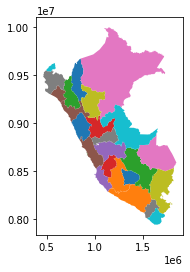

In [ ]:
roi_gpd.plot('DEPARTAMEN');

In [ ]:
roi_gpd.explore('DEPARTAMEN', tiles="CartoDB positron")

/usr/local/lib/python3.7/dist-packages/folium/features.py:909: UserWarning: GeoJsonTooltip is not configured to render for GeoJson GeometryCollection geometries. Please consider reworking these features: [{'COUNT': 109, 'FIRST_IDDP': '04', 'HECTARES': 6325588.935, 'NOMBDEP': 'AREQUIPA', '__folium_color': '#ff7f0e'}] to MultiPolygon for full functionality.
https://tools.ietf.org/html/rfc7946#page-9
  "https://tools.ietf.org/html/rfc7946#page-9".format(self._name, geom_collections), UserWarning)


In [ ]:
%%capture
!pip install git+https://github.com/martinfleis/geopandas-view.git

In [ ]:
from geopandas_view import view

view(roi_gpd, tiles="CartoDB positron")

/usr/local/lib/python3.7/dist-packages/folium/features.py:909: UserWarning: GeoJsonTooltip is not configured to render for GeoJson GeometryCollection geometries. Please consider reworking these features: [{'COUNT': 109, 'FIRST_IDDP': '04', 'HECTARES': 6325588.935, 'NOMBDEP': 'AREQUIPA'}] to MultiPolygon for full functionality.
https://tools.ietf.org/html/rfc7946#page-9
  "https://tools.ietf.org/html/rfc7946#page-9".format(self._name, geom_collections), UserWarning)


##### Distritos

In [ ]:
distritos = ee.FeatureCollection('users/CesarVilca/distritos')
roi_dict = distritos.getInfo()

roi_gpd  = gpd.GeoDataFrame.from_features(roi_dict, crs='epsg:4326') # crs : WGS 84
roi_gpd.head()

,geometry,AREA,CAPITAL,CODCCPP,DEPARTAMEN,DISTRITO,FUENTE,IDDIST,IDDPTO,IDPROV,PROVINCIA
0,"POLYGON ((-78.03815 -6.74455, -78.03815 -6.745...",1,BALSAS,0001,AMAZONAS,BALSAS,INEI,010103,01,0101,CHACHAPOYAS
1,"POLYGON ((-77.87606 -6.87222, -77.87498 -6.871...",1,LEIMEBAMBA,0001,AMAZONAS,LEIMEBAMBA,INEI,010110,01,0101,CHACHAPOYAS
2,"POLYGON ((-77.74509 -6.42727, -77.74716 -6.429...",1,LA JALCA,0001,AMAZONAS,LA JALCA,INEI,010109,01,0101,CHACHAPOYAS
3,"POLYGON ((-77.78226 -6.22755, -77.78138 -6.227...",1,DAGUAS,0001,AMAZONAS,SAN FRANCISCO DE DAGUAS,INEI,010118,01,0101,CHACHAPOYAS
4,"POLYGON ((-77.93611 -6.28550, -77.93551 -6.285...",1,CHACHAPOYAS,0001,AMAZONAS,CHACHAPOYAS,INEI,010101,01,0101,CHACHAPOYAS


In [ ]:
chongoyape_df = roi_gpd[roi_gpd['DISTRITO']=='CHONGOYAPE'].copy()
chongoyape_df

,geometry,AREA,CAPITAL,CODCCPP,DEPARTAMEN,DISTRITO,FUENTE,IDDIST,IDDPTO,IDPROV,PROVINCIA
1259,"POLYGON ((-79.38398 -6.78289, -79.38322 -6.781...",1,CHONGOYAPE,0001,LAMBAYEQUE,CHONGOYAPE,INEI,140102,14,1401,CHICLAYO


In [ ]:
chongoyape_df['geometry'] = chongoyape_df['geometry'].to_crs('epsg:32717') # UTM WGS84 17S
chongoyape_df

,geometry,AREA,CAPITAL,CODCCPP,DEPARTAMEN,DISTRITO,FUENTE,IDDIST,IDDPTO,IDPROV,PROVINCIA
1259,"POLYGON ((678595.927 9249954.724, 678680.098 9...",1,CHONGOYAPE,0001,LAMBAYEQUE,CHONGOYAPE,INEI,140102,14,1401,CHICLAYO


In [ ]:
chongoyape_df["area_m2"] = chongoyape_df['geometry'].area
chongoyape_df["area_km2"] = chongoyape_df['geometry'].area/ 10**6
chongoyape_df

,geometry,AREA,CAPITAL,CODCCPP,DEPARTAMEN,DISTRITO,FUENTE,IDDIST,IDDPTO,IDPROV,PROVINCIA,area_m2,area_km2
1259,"POLYGON ((678595.927 9249954.724, 678680.098 9...",1,CHONGOYAPE,0001,LAMBAYEQUE,CHONGOYAPE,INEI,140102,14,1401,CHICLAYO,7.212170e+08,721.216988


### Paletas para Visualización

Para la visualización de paletas:
- Visitar el catálogo de datos de Earth Engine
- Probar las ya disponibles en `geemap`

#### Índices de vegetación

In [ ]:
# @markdown **Paletas NDVI** 
#------------- Paletas de NDVI ---------------------------------------
ndviPalette01 = ['blue', 'white', 'green']

# https://developers.google.com/earth-engine/datasets/catalog/NASA_GIMMS_3GV0?hl=en
ndviPalette02 = ['000000', 'f5f5f5', '119701']

# https://developers.google.com/earth-engine/datasets/catalog/MODIS_006_MOD13A1?hl=en#description
ndviPalette03 = [
    'FFFFFF', 'CE7E45', 'DF923D', 'F1B555', 'FCD163', '99B718', '74A901',
    '66A000', '529400', '3E8601', '207401', '056201', '004C00', '023B01',
    '012E01', '011D01', '011301'
]

# Paleta NDVI (Yuri SIG) 20 Colores
# @markdown - `yuri_ndvi_pal`
yuri_ndvi_pal = [
    'ffffff', 'fffcff', 'fff9ff', 'fff7ff', 'fff4ff', 'fff2ff', 'ffefff',
    'ffecff', 'ffeaff', 'ffe7ff', 'ffe5ff', 'ffe2ff', 'ffe0ff', 'ffddff',
    'ffdaff', 'ffd8ff', 'ffd5ff', 'ffd3ff', 'ffd0ff', 'ffceff', 'ffcbff',
    'ffc8ff', 'ffc6ff', 'ffc3ff', 'ffc1ff', 'ffbeff', 'ffbcff', 'ffb9ff',
    'ffb6ff', 'ffb4ff', 'ffb1ff', 'ffafff', 'ffacff', 'ffaaff', 'ffa7ff',
    'ffa4ff', 'ffa2ff', 'ff9fff', 'ff9dff', 'ff9aff', 'ff97ff', 'ff95ff',
    'ff92ff', 'ff90ff', 'ff8dff', 'ff8bff', 'ff88ff', 'ff85ff', 'ff83ff',
    'ff80ff', 'ff7eff', 'ff7bff', 'ff79ff', 'ff76ff', 'ff73ff', 'ff71ff',
    'ff6eff', 'ff6cff', 'ff69ff', 'ff67ff', 'ff64ff', 'ff61ff', 'ff5fff',
    'ff5cff', 'ff5aff', 'ff57ff', 'ff55ff', 'ff52ff', 'ff4fff', 'ff4dff',
    'ff4aff', 'ff48ff', 'ff45ff', 'ff42ff', 'ff40ff', 'ff3dff', 'ff3bff',
    'ff38ff', 'ff36ff', 'ff33ff', 'ff30ff', 'ff2eff', 'ff2bff', 'ff29ff',
    'ff26ff', 'ff24ff', 'ff21ff', 'ff1eff', 'ff1cff', 'ff19ff', 'ff17ff',
    'ff14ff', 'ff12ff', 'ff0fff', 'ff0cff', 'ff0aff', 'ff07ff', 'ff05ff',
    'ff02ff', 'ff00ff', 'ff00ff', 'ff0af4', 'ff15e9', 'ff1fdf', 'ff2ad4',
    'ff35c9', 'ff3fbf', 'ff4ab4', 'ff55aa', 'ff5f9f', 'ff6a94', 'ff748a',
    'ff7f7f', 'ff8a74', 'ff946a', 'ff9f5f', 'ffaa55', 'ffb44a', 'ffbf3f',
    'ffc935', 'ffd42a', 'ffdf1f', 'ffe915', 'fff40a', 'ffff00', 'ffff00',
    'fffb00', 'fff700', 'fff300', 'fff000', 'ffec00', 'ffe800', 'ffe400',
    'ffe100', 'ffdd00', 'ffd900', 'ffd500', 'ffd200', 'ffce00', 'ffca00',
    'ffc600', 'ffc300', 'ffbf00', 'ffbb00', 'ffb700', 'ffb400', 'ffb000',
    'ffac00', 'ffa800', 'ffa500', 'ffa500', 'f7a400', 'f0a300', 'e8a200',
    'e1a200', 'd9a100', 'd2a000', 'ca9f00', 'c39f00', 'bb9e00', 'b49d00',
    'ac9c00', 'a59c00', '9d9b00', '969a00', '8e9900', '879900', '7f9800',
    '789700', '709700', '699600', '619500', '5a9400', '529400', '4b9300',
    '439200', '349100', '2d9000', '258f00', '1e8e00', '168e00', '0f8d00',
    '078c00', '008c00', '008c00', '008700', '008300', '007f00', '007a00',
    '007600', '007200', '006e00', '006900', '006500', '006100', '005c00',
    '005800', '005400', '005000', '004c00'
]

In [ ]:
# @markdown **Paletas EVI**
#------------- Paletas de EVI ---------------------------------------
evi_palette = [
    'ffffff', 'fcd163', '99b718', '66a000', '3e8601', '207401', '056201',
    '004c00', '011301'
]

ndvi_palette = [
    "#051852", "#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00",
    "#429001", "#006400", "#003B00", "#000000"
]

#### DEM

ALOS: https://developers.google.com/earth-engine/datasets/catalog/JAXA_ALOS_AW3D30_V2_2


In [ ]:
#@markdown **Paletas para DEMs**

# Paleta Inferno 
inferno_pal = ["#000004", "#560F6D", "#BB3654", "#F98C09", "#FCFFA4"]

# Paleta ALOS
palette = ['0000ff', '00ffff', 'ffff00', 'ff0000', 'ffffff']

#### Temperatura de Brillo (Brightness temperature)

##### Landsat 5

In [9]:
#@markdown **Paletas para mapas de temperatura**: `temp_pal`

temp_pal = ['040274', '040281', '0502a3', '0502b8', '0502ce', '0502e6',
            '0602ff', '235cb1', '307ef3', '269db1', '30c8e2', '32d3ef',
            '3be285', '3ff38f', '86e26f', '3ae237', 'b5e22e', 'd6e21f',
            'fff705', 'ffd611', 'ffb613', 'ff8b13', 'ff6e08', 'ff500d',
            'ff0000', 'de0101', 'c21301', 'a71001', '911003']

In [44]:
# @markdown Visualización de paleta de temperatura\
# @markdown imagen Landsat 5 ETM Banda 6: Temperatura de Brillo

# Ejemplo cuando se tienen cordenadas
zona = ee.Geometry.Polygon([[[-70.955762, -13.554665],
                             [-70.955762, -13.251976],
                             [-70.655819, -13.251976],
                             [-70.655819, -13.554665],
                             [-70.955762, -13.554665]]])

L5_RS = (
    ee.ImageCollection("LANDSAT/LT05/C01/T1_SR")
    .filterDate('2005-01-01','2009-12-31')
    .filterBounds(zona)
    .filterMetadata('CLOUD_COVER','less_than',20)
    .sort('CLOUD_COVER')
    .first()
)

# Kelvin a Celsius es: Tc = Tk - 273.15
L5_RS_TB = (
    L5_RS.select('B6')
    .subtract(273.15)
    .multiply(0.01)
)
          
# Crear su simbologia TB
viz_tb = {'min': 15, 'max': 30, 'palette': temp_pal}
viz_es = {'min': 0.1, 'max': 0.6, 'gamma':1.6, 'bands': ['B5', 'B4', 'B3']}

# Visualizacion temperatura brillo
Map = geemap.Map(height='800px')# basemap = 'HYBRID', layer_ctrl=True)
Map.center_object(zona, zoom=10)
Map.addLayer(L5_RS_TB, viz_tb, name = "L5 TB B6 Celsius")
Map.addLayer(L5_RS.multiply(0.0001), viz_es, name = "L5 SR")
Map.addLayer(zona, {}, name = "Zona")
Map

Map(center=[-13.40333300316476, -70.80579050000095], controls=(WidgetControl(options=['position', 'transparent…

In [40]:
# L5_RS_TB, usamos bestEffort porque sacaremos datos de toda la imagen Landsat
L5_RS_TBmin = L5_RS_TB.reduceRegion(reducer=ee.Reducer.min(), scale=30, bestEffort=True).get('B6').getInfo()
L5_RS_TBmax = L5_RS_TB.reduceRegion(reducer=ee.Reducer.max(), scale=30, bestEffort=True).get('B6').getInfo()

print(f'Temperatura mínima de {L5_RS_TBmin}°C')
print(f'Temperatura máxima de {L5_RS_TBmax}°C')

Temperatura mínima de 17.6085°C
Temperatura máxima de 29.2385°C


In [ ]:
# Exportar imagen Temperatura de brillo B6
geemap.ee_export_image(L5_RS.clip(zona), 
                       filename="L5_RS.tif", 
                       scale=30, 
                       region=zona, 
                       file_per_band=True)

Generating URL ...
Please wait ...
Data downloaded to /content


##### Landsat 8 - TOA

In [76]:
icol_l8_toa = (
    ee.ImageCollection("LANDSAT/LC08/C01/T1_TOA")
    .filterMetadata('WRS_PATH', 'equals', 10)
    .filterMetadata('WRS_ROW', 'equals', 65)
    .filterDate('2021-01-01','2021-12-31')
    .filterMetadata('CLOUD_COVER', 'less_than', 20)
    .sort('CLOUD_COVER')
)

fecha_img = icol_l8_toa.first().date().format('Y-MM-dd').getInfo()
print(fecha_img)

asset_distritos = ee.FeatureCollection('users/CesarVilca/distritos')
chongoyape = asset_distritos.filterMetadata('DISTRITO','equals','CHONGOYAPE')
chongoyape_bound = chongoyape.geometry().bounds() # CAJA

# Kelvin a Celsius es: Tc = Tk - 273.15
icol_l8_toa_TB = (
    icol_l8_toa.first()
    .clip(chongoyape_bound)
    .select('B10')
    .subtract(273.15)
)

2021-02-03


In [75]:
# Obtener rangos de temperatura para visualización
L8_TBmin = icol_l8_toa_TB.reduceRegion(reducer=ee.Reducer.min(), geometry=chongoyape_bound, scale=30).get('B10').getInfo()
L8_TBmax = icol_l8_toa_TB.reduceRegion(reducer=ee.Reducer.max(), geometry=chongoyape_bound, scale=30).get('B10').getInfo()
print(f'Temperatura mínima de {L8_TBmin:.2f}°C')
print(f'Temperatura máxima de {L8_TBmax:.2f}°C') 

Temperatura mínima de 17.75°C
Temperatura máxima de 35.88°C


In [74]:
# Visualización
viz_tb = {'min': 15, 'max': 40, 'palette': temp_pal}
viz_es = {'min': 0, 'max': 0.3, 'bands': ['B4', 'B3', 'B2']}

# Visualizacion temperatura brillo
Map = geemap.Map(height='700px')# basemap = 'HYBRID', layer_ctrl=True)
Map.center_object(icol_l8_toa_TB, zoom=11)
Map.addLayer(icol_l8_toa.first(), viz_es, name = "L8 TOA")
Map.addLayer(chongoyape_bound, {}, name = "Zona")
Map.addLayer(icol_l8_toa_TB, viz_tb, name = "L8 TB B10 Celsius")
Map

Map(center=[-6.632327892333842, -79.47072070660616], controls=(WidgetControl(options=['position', 'transparent…

## Exploración de Datasets

### Landsat 8

**Referencias**

- Earth Engine Catalog: [Landsat](https://developers.google.com/earth-engine/datasets/catalog/landsat-8)
  - What are the best Landsat spectral bands for use in my research? [USGS](https://www.usgs.gov/faqs/what-are-best-landsat-spectral-bands-use-my-research?qt-news_science_products=0#qt-news_science_products)
  - What are the processing levels for Landsat Level-1 data? [USGS](https://www.usgs.gov/faqs/what-are-processing-levels-landsat-level-1-data?qt-news_science_products=0#qt-news_science_products)
  - Landsat Known Issues [USGS](https://www.usgs.gov/core-science-systems/nli/landsat/landsat-known-issues)
- Analyzing a Landsat 8 image in Google Earth Engine: [Youtube](https://www.youtube.com/watch?v=TCCfENwZOFI)
  - Buscar en el code editor de earth engine: `Examples/User Interface/..`

#### Collection 2

### Filtrado de `ee.ImageCollection`

https://developers.google.com/earth-engine/apidocs/ee-imagecollection-filtermetadata

```
img_col = ee.ImageCollection(Product_name)\
            .filterDate(range_date[0], range_date[1])\
            .filterBounds(roi)\
            .filterMetadata('CLOUDY_PIXEL_PERCENTAGE', 'lt', Cloud_Pixel_Percentage)
```

In [ ]:
#@markdown Ejemplo de un filtrado de ee.ImageCollection

def filter_icol(img_col, aoi, Start_date, End_date, Cloud_Pixel_Percentage):
  """
  img_col : ee.ImageCollecion
  aoi: ee.Geometry()
  Star_date & End_date : str
  Cloud_Pixel_Percentage : int o float
  """
  return (
      img_col.filterBounds(aoi)\
      .filterDate(Start_date, End_date)\
      .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE',Cloud_Pixel_Percentage))
  )

print('filter_icol(img_col, aoi, Start_date, End_date, Cloud_Pixel_Percentage) listo!')

In [ ]:
# @markdown Area de estudio: Chincha \
# @markdown  Necesario para correr la siguiente visualización
area_1 = ee.FeatureCollection('users/CesarVilca/area_1')     
area_2 = ee.FeatureCollection('users/CesarVilca/area_2')    # 1 imagen Sentinel
area_3 = ee.FeatureCollection('users/CesarVilca/area_3')    # 2 imágenes Sentinel
area_total = ee.FeatureCollection('users/CesarVilca/area_total')

roi = area_2.geometry().bounds() # Arrojará 1 imagen Sentinel
centroide = [-76.0908, -13.4589] # centroid = img.geometry().centroid().getInfo()['coordinates']

roi_clip = area_total.geometry().bounds()

In [ ]:
#@title Visualización de Imágenes Sentinel-2 Surface Reflectance

#@markdown 1. Selección del producto:
Product_name = 'COPERNICUS/S2_SR'  #@param ["COPERNICUS/S2", "COPERNICUS/S2_SR"]

#@markdown 2. Seleccionamos las fechas de interés:
Start_date = '2012-12-17'  #@param {type: "date"}
End_date   = '2020-12-19'  #@param {type: "date"}

#@markdown 3. Porcentaje de Nubosidad:
Cloud_Pixel_Percentage =    0.3#@param {type:"number"}

#  Parametros globales
range_date = [Start_date, End_date]

#-----------------------------------------
#      ImageCollection y Filtrado
#-----------------------------------------

#@markdown 4. Variable del ImageColecction: **`img_col`**
# ee.ImageCollection filtrado de fechas, area y % de nubes
img_col = ee.ImageCollection(Product_name)\
         .filterDate(range_date[0], range_date[1])\
         .filterBounds(roi)\
         .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE',Cloud_Pixel_Percentage)) 

img_col = ee.ImageCollection(Product_name)\
            .filterDate(range_date[0], range_date[1])\
            .filterBounds(roi)\
            .filterMetadata('CLOUDY_PIXEL_PERCENTAGE', 'lt', Cloud_Pixel_Percentage)
# Cantidad de Imágenes
print('Total de imágenes:', img_col.size().getInfo())

#-----------------------------------------
#                  Fechas
#-----------------------------------------

# Reducer.minMax() yo puedo quedarme o reducir la coleccion 
# respecto a un minimo o un maximo (respecto al tiempo en este caso)
# ee.Reducer.minMax(), ["system:time_start"] da un JSON
# para transformarlo a tabla: 
# collection.reduceColumns(ee.Reducer.minMax(), ["system:time_start"])
# al ser una tabla, es posible aplicar mas metodos

rango = img_col.reduceColumns(ee.Reducer.minMax(), ["system:time_start"])
# Ejemplo: rango = {'max': 1608132402761, 'min': 1545060401000}

from datetime import datetime as dt

# Obtención de la fecha min y max del image collection
init_date = ee.Date(rango.get('min')).getInfo()['value']/1000.
last_date = ee.Date(rango.get('max')).getInfo()['value']/1000.

# fecha numérica a ISO standard 8601 
# Javascript trabaja las fechas con milisegundos (se deja así)
# Python     trabaja las fechas con segundos (por eso /1000

init_date_f = dt.utcfromtimestamp(init_date).strftime('%Y-%m-%d %H:%M:%S')
last_date_f = dt.utcfromtimestamp(last_date).strftime('%Y-%m-%d %H:%M:%S')

# Obtenga el rango de fechas de las imágenes en la colección.
print('Rango Temporal Ingresado :', range_date[0],' - ', range_date[1])
print('Rango Temporal Real      :', init_date_f,' - ', last_date_f)

#-----------------------------------------
#              Visualización 
#-----------------------------------------
#@markdown 5. Visualización de imagen en RGB (Median) 

# Retorna: ee.Image
img_col_clip = img_col.select(['B4','B3','B2'])\
                        .median()\
                        .divide(10000)\
                        .clip(roi_clip) # válido solo en ee.Image

# Visualización de la imagen en color natural
bands  = ['B4','B3','B2'] # Natural Color
mydicc = {
    'Natural Color': img_col_clip.getMapId({'min':0,'max':0.3,'bands':bands}),
    'Region of interest (ROI)': area_total.getInfo()}

mapdisplay(centroide, mydicc,zoom_start=12)

## Descargas

**Descarga de Imágenes en GEE API Python**

Para más información sobre la forma de exportar información de GEE: [Exporting data](https://developers.google.com/earth-engine/guides/python_install#exporting-data)

In [ ]:
# @markdown *Monitoreo de tareas (tiempo)*
import time 
def ee_monitoring(ee_task):
  while ee_task.active():
    print('Sondeo de la tarea (id: {}).', format(ee_task.id))
    time.sleep(5)
#ee_monitoring(task)

## Funciones Realizadas

### Enmascarar nubes: Sentinel-2

In [ ]:
# @markdown Función `maskS2clouds(image)` 
# @markdown para enmascarar nubes en imágenes Sentinel-2

# @markdown **Nota**: Aplica la división por 10000

## Operadores de bit a bit
# Operador bit a bit desplazamiento a la izquierda <<
# Little indian (los bits se cuentan de izq a derecha) y 
# Big indian (los bits se cuentan de derecha a izq)
def maskS2clouds(image):
  qa = image.select('QA60')
  opaque_cloud = 1 << 10
  cirrus_cloud = 1 << 11
  mask = (
      qa.bitwiseAnd(opaque_cloud).eq(0)
      .And(qa.bitwiseAnd(cirrus_cloud).eq(0))
  )
  clean_image = (
      image.updateMask(mask)
      .divide(10000)
      .copyProperties(image, ["system:time_start"])
  )
  return clean_image

# Se retorna la información de fecha ya que se pierde al dividir

Mayor información: https://developers.google.com/earth-engine/datasets/catalog/COPERNICUS_S2_SR#description

In [ ]:
snippet_name = 'COPERNICUS/S2_SR'
year = 2021

# Filtrado: Usar roi o parcelas_chongoyape
roi = ee.Geometry.Point([-79.39762925890398, -6.612494380904333])
parcelas_chongoyape = ee.FeatureCollection("users/CesarVilca/parcelas_chongoyape").geometry() # Abarca 1139 puntos en una imagen sentinel-2

icol = (
    ee.ImageCollection(snippet_name)
    .filterDate(str(year), str(year+1))
    .filterBounds(roi)
    .map(maskS2clouds) # Incluye el dividir por 10000
)

### Índices Espectrales: Landsat 8



**Mapping sobre una ImageCollection**

Para aplicar una funcion a cada imagen en una ImageCollection, use **`imageCollection.map()`**. El unico argumento para **`map()`** es una funcion que toma un parametro: un **`ee.Image`**. 

<center>
<img src = 'https://user-images.githubusercontent.com/16768318/72934781-27aa9e00-3d5c-11ea-99f9-15117ab864bb.png' width  =300px>
</center>

**Operadores Google Earth Engine**

 _ | _ | GEE
--------------|-------------|-------------
Arithmetic	|+ - * / % **	|add, subtract, multiply, divide, mod, exp
Comparison	| == != < > <= >= |	eq, neq, lt, gt, lte,gte.
Logical |	&& \|\| ! ^	| And, Or, Not, Xor

In [8]:
# @markdown Indices de Vegetación:
# @markdown - NDVI
# @markdown   - Función `get_ndvi_S2(image)`
# @markdown   - Función `get_ndvi_L8(image)`
# @markdown   - Función `get_ndvi_L7(image)`
# @markdown - EVI
# @markdown   - Función `get_evi_S2(image)`

def get_ndvi_S2(image):
  ndvi = image.expression(
      '(nir - red) / (nir + red)',
      {'red' : image.select('B4').divide(10000),
       'nir' : image.select('B8').divide(10000)}).rename('NDVI')
  return image.addBands(ndvi)
  
def get_ndvi_L8(image):
  ndvi = image.expression(
      '(nir - red) / (nir + red)',
      {'red' : image.select('SR_B4').multiply(0.0000275).add(-0.2),
       'nir' : image.select('SR_B5').multiply(0.0000275).add(-0.2)}
       ).rename('NDVI')
  return image.addBands(ndvi)

def get_ndvi_L7(image):
  ndvi = image.expression(
      '(nir - red) / (nir + red)',
      {'red' : image.select('SR_B3').multiply(0.0000275).add(-0.2),
       'nir' : image.select('SR_B4').multiply(0.0000275).add(-0.2)}
       ).rename('NDVI')
  return image.addBands(ndvi)

# def ndvi_icol(image):
#   ndvi = image.normalizedDifference(['B8','B4']).rename('ndvi')
#   return image.addBands([ndvi])


def get_evi_S2(image):
  """
  https://developers.google.com/earth-engine/guides/image_math#expressions
  """
  evi = image.expression(
      '2.5 * (nir - red) / (nir + 6 * red - 7.5 * blue + 1)',
      {'red' : image.select('B4').divide(10000),
       'nir' : image.select('B8').divide(10000),
       'blue': image.select('B2').divide(10000)}
       ).rename('EVI')

  return image.addBands(evi)

### Generar reporte de un ImageCollection

Iniciar visualización interactiva de `pandas`:

    %load_ext google.colab.data_table

Volver a la visualización de `pandas` por defecto:

    %unload_ext google.colab.data_table

**OJO**: No es recomendable usarlo a la vez que se quiera visualizar un GeoDataFrame (geopandas) ya que presentará toda la información de geometría. 


In [ ]:
%load_ext google.colab.data_table

Para omitir ciertas columnas es necesario comentar las líneas de código que no se requieran.

In [ ]:
# @title Landsat 8 Surface Reflectance
# @markdown Función: `generar_reporte_landsat8_T1_SR(path=None, row=None, year=None)`
def generar_reporte_landsat8_T1_SR(path=None, row=None, year=None):

  ID_snippet_name = "LANDSAT/LC08/C01/T1_SR"
  ## Filtrado de ee.imageCollection
  icol_sr = (
      ee.ImageCollection(ID_snippet_name)\
      .filterDate(str(year), str(year+1))\
      .filterMetadata('WRS_PATH', 'equals', path)\
      .filterMetadata('WRS_ROW', 'equals', row)
  )

  ## Generando campos para la tabla
  # Lista con fechas (en milisegundos)
  lista_fechas = icol_sr.aggregate_array('system:time_start').getInfo()

  # Lista con ID's
  imgCol_ids = [
                ID_snippet_name + 
                '/'+ 
                i for i in icol_sr.aggregate_array("system:index").getInfo()]

  # Tabla con pandas
  import pandas as pd

  df = pd.DataFrame(lista_fechas, columns = ['millis'])

  df["Landsat ID"] = imgCol_ids
  df['Timestamp'] = pd.to_datetime(df['millis'], unit='ms')
  df['Fecha Precisa'] = pd.DatetimeIndex(df['Timestamp']) # Con hora
  df['Fecha Corta'] = pd.DatetimeIndex(df['Timestamp']).date
  df['Año'] = pd.DatetimeIndex(df['Timestamp']).year
  df['Mes'] = pd.DatetimeIndex(df['Timestamp']).month
  df['Día'] = pd.DatetimeIndex(df['Timestamp']).day
  df['Hora'] = pd.DatetimeIndex(df['Timestamp']).hour
  df['Día Juliano'] = pd.DatetimeIndex(df['Timestamp']).dayofyear
  # df['Sensor'] = 'OLI/TIRS'
  
  df["Zenith Angle"] = icol_sr.aggregate_array('SOLAR_ZENITH_ANGLE').getInfo()
  df["Porcentaje Nubes (%)"] = icol_sr.aggregate_array('CLOUD_COVER').getInfo()
  
  df = df.drop(columns=['millis', 'Timestamp'])
  # df.to_csv('datos_2020_L8_SR.csv')

  return df

In [ ]:
generar_reporte_landsat8_T1_SR(path=10, row=65, year=2021)

,Landsat ID,Fecha Precisa,Fecha Corta,Año,Mes,Día,Hora,Día Juliano,Zenith Angle,Porcentaje Nubes (%)
0,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210102,2021-01-02 15:28:34.101,2021-01-02,2021,1,2,15,2,31.894131,40.61
1,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210203,2021-02-03 15:28:25.244,2021-02-03,2021,2,3,15,34,31.967308,2.62
2,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210307,2021-03-07 15:28:13.534,2021-03-07,2021,3,7,15,66,30.574303,35.30
3,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210323,2021-03-23 15:28:06.322,2021-03-23,2021,3,23,15,82,30.729298,11.67
4,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210408,2021-04-08 15:28:01.927,2021-04-08,2021,4,8,15,98,31.944176,48.31
5,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210424,2021-04-24 15:27:54.495,2021-04-24,2021,4,24,15,114,34.098743,28.75
6,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210510,2021-05-10 15:27:49.775,2021-05-10,2021,5,10,15,130,36.695053,9.94
7,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210526,2021-05-26 15:27:59.826,2021-05-26,2021,5,26,15,146,39.111782,88.94
8,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210611,2021-06-11 15:28:06.858,2021-06-11,2021,6,11,15,162,40.849697,97.44
9,LANDSAT/LC08/C01/T1_SR/LC08_010065_20210627,2021-06-27 15:28:11.059,2021-06-27,2021,6,27,15,178,41.507404,88.26


In [ ]:
# @title Sentinel-2 Surface Reflectance
# @markdown Función: `generar_reporte_S2_SR(roi, year)`
def generar_reporte_S2_SR(roi, year):

  ID_snippet_name = 'COPERNICUS/S2_SR'

  ## Filtrado de ee.imageCollection
  icol_sr = (
      ee.ImageCollection(ID_snippet_name)\
      .filterDate(str(year), str(year+1))\
      .filterBounds(roi)
  )

  ## Generando campos para la tabla
  # Lista con fechas (en milisegundos)
  lista_fechas = icol_sr.aggregate_array('system:time_start').getInfo()

  # Lista con ID's
  imgCol_ids = [f'{ID_snippet_name}/{i}' for i in icol_sr.aggregate_array("system:index").getInfo()]

  # Tabla con pandas
  import pandas as pd

  df = pd.DataFrame(lista_fechas, columns = ['millis'])

  df['Sentinel-2 ID'] = imgCol_ids
  df['Timestamp'] = pd.to_datetime(df['millis'], unit='ms')
  df['Fecha Precisa'] = pd.DatetimeIndex(df['Timestamp']) # Con hora
  df['Fecha Corta'] = pd.DatetimeIndex(df['Timestamp']).date
  df['Año'] = pd.DatetimeIndex(df['Timestamp']).year
  df['Mes'] = pd.DatetimeIndex(df['Timestamp']).month
  df['Día'] = pd.DatetimeIndex(df['Timestamp']).day
  df['Hora'] = pd.DatetimeIndex(df['Timestamp']).hour
  df['Día Juliano'] = pd.DatetimeIndex(df['Timestamp']).dayofyear
  # df['Sensor'] = 'OLI/TIRS'
  
  df["Zenith Angle"] = icol_sr.aggregate_array('MEAN_SOLAR_ZENITH_ANGLE').getInfo()
  df["Porcentaje Nubes (%)"] = icol_sr.aggregate_array('CLOUDY_PIXEL_PERCENTAGE').getInfo()
  
  df = df.drop(columns=['millis', 'Timestamp'])
  # df.to_csv('datos_2020_L8_SR.csv')
  return df

In [ ]:
chongoyape = ee.Geometry.Point([-79.389, -6.639]) 
generar_reporte_S2_SR(chongoyape, 2021)

,Sentinel-2 ID,Fecha Precisa,Fecha Corta,Año,Mes,Día,Hora,Día Juliano,Zenith Angle,Porcentaje Nubes (%)
0,COPERNICUS/S2_SR/20210101T153619_20210101T1544...,2021-01-01 15:45:05.914,2021-01-01,2021,1,1,15,1,28.362474,60.175373
1,COPERNICUS/S2_SR/20210106T153621_20210106T1540...,2021-01-06 15:45:08.039,2021-01-06,2021,1,6,15,6,28.540159,96.552039
2,COPERNICUS/S2_SR/20210111T153619_20210111T1537...,2021-01-11 15:45:06.966,2021-01-11,2021,1,11,15,11,28.625081,14.484162
3,COPERNICUS/S2_SR/20210116T153621_20210116T1540...,2021-01-16 15:45:08.324,2021-01-16,2021,1,16,15,16,28.601828,92.622773
4,COPERNICUS/S2_SR/20210121T153619_20210121T1537...,2021-01-21 15:45:07.362,2021-01-21,2021,1,21,15,21,28.493682,27.849255
...,...,...,...,...,...,...,...,...,...,...
62,COPERNICUS/S2_SR/20211102T153621_20211102T1540...,2021-11-02 15:45:11.626,2021-11-02,2021,11,2,15,306,20.498575,3.990879
63,COPERNICUS/S2_SR/20211107T153619_20211107T1536...,2021-11-07 15:45:07.742,2021-11-07,2021,11,7,15,311,21.140111,66.983148
64,COPERNICUS/S2_SR/20211112T153621_20211112T1540...,2021-11-12 15:45:09.353,2021-11-12,2021,11,12,15,316,21.862431,9.316200
65,COPERNICUS/S2_SR/20211117T153619_20211117T1537...,2021-11-17 15:45:05.511,2021-11-17,2021,11,17,15,321,22.667283,12.258994


In [ ]:
# @markdown Función `generar_reporte(ID_snippet_name, year, roi)` 
# @markdown - Nota: Usar si solo es una imagen

def generar_reporte(ID_snippet_name, year, roi):
  
  icol_filtered = (
      ee.ImageCollection(ID_snippet_name)\
      .filterDate(str(year), str(year+1))\
      .filterBounds(roi)
  )

  lista_fechas = icol_filtered.aggregate_array('system:time_start').getInfo() # Fechas
  imgCol_ids = [f'{ID_snippet_name}/{i}' for i in icol_filtered.aggregate_array("system:index").getInfo()] # ID

  # Armando dataframe
  df = pd.DataFrame(lista_fechas, columns = ['millis'])

  df["Landsat ID"] = imgCol_ids
  df['Timestamp'] = pd.to_datetime(df['millis'], unit='ms')
  df['Fecha Precisa'] = pd.DatetimeIndex(df['Timestamp']) # Con hora
  # df['Fecha Corta'] = pd.DatetimeIndex(df['Timestamp']).date
  df['Año'] = pd.DatetimeIndex(df['Timestamp']).year
  df['Mes'] = pd.DatetimeIndex(df['Timestamp']).month
  df['Día'] = pd.DatetimeIndex(df['Timestamp']).day
  # df['Hora'] = pd.DatetimeIndex(df['Timestamp']).hour
  df['Día Juliano'] = pd.DatetimeIndex(df['Timestamp']).dayofyear

  # Agregando propiedades
  if ID_snippet_name == 'LANDSAT/LC08/C01/T1_SR':
    df["Zenith Angle"] = icol_filtered.aggregate_array('SOLAR_ZENITH_ANGLE').getInfo()
    df["Porcentaje Nubes (%)"] = icol_filtered.aggregate_array('CLOUD_COVER').getInfo()
  
  elif ID_snippet_name == 'COPERNICUS/S2_SR':
    df["Zenith Angle"] = icol_filtered.aggregate_array('MEAN_SOLAR_ZENITH_ANGLE').getInfo()
    df["Porcentaje Nubes (%)"] = icol_filtered.aggregate_array('CLOUDY_PIXEL_PERCENTAGE').getInfo()
  
  df = df.drop(columns=['millis', 'Timestamp'])
  # df.to_csv('datos_2020_L8_SR.csv')
  
  return df

In [ ]:
interact(generar_reporte, ID_snippet_name=['COPERNICUS/S2_SR', 'LANDSAT/LC08/C01/T1_SR'], year=[2020, 2021], roi=fixed(chongoyape));

###### Forma 1

In [ ]:
import pandas as pd

In [ ]:
# @markdown *Intento 1* : `generarReporteAnual()`

def listar_propiedades(imgCol=None, propiedad=None):
  return imgCol.reduceColumns(ee.Reducer.toList(),[propiedad]).get("list").getInfo()

def listar_fecha(imgCol):
    def func_ejv(im):
        return ee.String(ee.Image(im).date().format('YYYY/MM/dd')).slice(0)
    return imgCol.toList(imgCol.size(), 0).map(func_ejv).getInfo()

def generarReporteAnual(ID_ImgCol_name=None, long=None, lat=None, inicio=None, fin=None):
  imgCol = ee.ImageCollection(ID_ImgCol_name)\
             .filterDate(inicio, fin)\
             .filterBounds(ee.Geometry.Point([long, lat]))

  dic = {
      "ID": listar_propiedades(imgCol, "LANDSAT_ID"), 
      "Fecha": listar_fecha(imgCol),
      "Porcentaje Nube (%)": listar_propiedades(imgCol, "CLOUD_COVER"),
      "PATH": listar_propiedades(imgCol, "WRS_PATH"),
      "ROW": listar_propiedades(imgCol, "WRS_ROW"),
      "Zenith Angle": listar_propiedades(imgCol, "SOLAR_ZENITH_ANGLE"),
      }
  
  df1 = pd.DataFrame(dic)
  return df1

In [ ]:
generarReporteAnual("LANDSAT/LC08/C01/T1_SR", -79.809, -6.746, '2020-01-01', '2021-01-01')

,ID,Fecha,Porcentaje Nube (%),PATH,ROW,Zenith Angle
0,LC08_L1TP_010065_20200116_20200128_01_T1,2020/01/16,3.14,10,65,32.330326
1,LC08_L1TP_010065_20200201_20200211_01_T1,2020/02/01,61.18,10,65,32.084152
2,LC08_L1TP_010065_20200217_20200225_01_T1,2020/02/17,5.40,10,65,31.332012
3,LC08_L1TP_010065_20200304_20200314_01_T1,2020/03/04,3.55,10,65,30.655491
4,LC08_L1TP_010065_20200320_20200326_01_T1,2020/03/20,12.42,10,65,30.643269
5,LC08_L1TP_010065_20200405_20200410_01_T1,2020/04/05,60.64,10,65,31.678082
6,LC08_L1TP_010065_20200421_20200508_01_T1,2020/04/21,1.66,10,65,33.694965
7,LC08_L1TP_010065_20200507_20200509_01_T1,2020/05/07,27.11,10,65,36.267532
8,LC08_L1TP_010065_20200523_20200607_01_T1,2020/05/23,71.28,10,65,38.752293
9,LC08_L1TP_010065_20200608_20200625_01_T1,2020/06/08,87.18,10,65,40.636333


###### Forma 2

Fuente: [Time Series Visualization with Altair - Add date columns](https://developers.google.com/earth-engine/tutorials/community/time-series-visualization-with-altair#add_date_columns)

In [ ]:
# @markdown *Intento 2* : 
# @markdown Generar tabla de resultados con `pandas`

long = -79.809 #@param [] {type:"raw", allow-input: true}
lat = -6.746 #@param [] {type:"raw", allow-input: true}
coordenada = [long, lat]

year =  2020 #@param {type:"integer"}
Start_date = str(year) + '-01-01' 
End_date   = str(year+1) + '-01-01' 
range_date = [Start_date, End_date]

ID_snippet_name = "LANDSAT/LC08/C01/T1_SR" 

icol_sr = ee.ImageCollection(ID_snippet_name)\
            .filterDate(range_date[0], range_date[1])\
            .filterBounds(ee.Geometry.Point(coordenada))

# Generar lista de fechas (en milisegundos)
lista_fechas = icol_sr.aggregate_array('system:time_start').getInfo()
icol_sr_ids = [ID_snippet_name + 
              '/'+ 
              i for i in icol_sr.aggregate_array("system:index").getInfo()]

# Generar tabla con pandas
import pandas as pd
df = pd.DataFrame(lista_fechas, columns = ['millis'])

def add_date_info(df):
  df['Landsat ID'] = icol_sr_ids

  df['Timestamp'] = pd.to_datetime(df['millis'], unit='ms')
  df['Fecha Precisa'] = pd.DatetimeIndex(df['Timestamp'])
  df['Fecha Corta'] = pd.DatetimeIndex(df['Timestamp']).date
  df['Día Juliano'] = pd.DatetimeIndex(df['Timestamp']).dayofyear
  df['Año'] = pd.DatetimeIndex(df['Timestamp']).year
  df['Mes'] = pd.DatetimeIndex(df['Timestamp']).month
  df['Día'] = pd.DatetimeIndex(df['Timestamp']).day
  df['Hora'] = pd.DatetimeIndex(df['Timestamp']).hour
  df['Sensor'] = 'OLI/TIRS'
  
  df = df.drop(columns=['millis'])
  df = df.drop(columns=['Timestamp'])
  return df

df = add_date_info(df)
print(df.to_string(index=False))

# print(df.to_string(index=False)) # print básico

# Exportar como .csv 
# df.to_csv('datos_2020_L8.csv')
# lista_fechas

###### Forma 3

In [ ]:
# @markdown *Función* : `generarReporteAnual()`

import pandas as pd

def listar_propiedades(imgCol=None, propiedad=None):
  return imgCol.reduceColumns(ee.Reducer.toList(),[propiedad]).get("list").getInfo()

def listar_fecha(imgCol):
    def func_ejv(im):
        return ee.String(ee.Image(im).date().format('YYYY/MM/dd')).slice(0)
    return imgCol.toList(imgCol.size(), 0).map(func_ejv).getInfo()

def generarReporteAnual(ID_ImgCol_name=None, long=None, lat=None, inicio=None, fin=None):
  imgCol = ee.ImageCollection(ID_ImgCol_name)\
             .filterDate(inicio, fin)\
             .filterBounds(ee.Geometry.Point([long, lat]))

  dic = {
      "ID": listar_propiedades(imgCol, "LANDSAT_ID"), 
      "Fecha": listar_fecha(imgCol),
      "Porcentaje Nube (%)": listar_propiedades(imgCol, "CLOUD_COVER"),
      "PATH": listar_propiedades(imgCol, "WRS_PATH"),
      "ROW": listar_propiedades(imgCol, "WRS_ROW"),
      "Zenith Angle": listar_propiedades(imgCol, "SOLAR_ZENITH_ANGLE"),
      }
  
  df1 = pd.DataFrame(dic)
  return df1

In [ ]:
# Ejemplo 1

# Cargar visualización interactiva de pandas
%load_ext google.colab.data_table

generarReporteAnual("LANDSAT/LC08/C01/T1_SR", -79.809, -6.746, '2020-01-01', '2021-01-01')

,ID,Fecha,Porcentaje Nube (%),PATH,ROW,Zenith Angle
0,LC08_L1TP_010065_20200116_20200128_01_T1,2020/01/16,3.14,10,65,32.330326
1,LC08_L1TP_010065_20200201_20200211_01_T1,2020/02/01,61.18,10,65,32.084152
2,LC08_L1TP_010065_20200217_20200225_01_T1,2020/02/17,5.40,10,65,31.332012
3,LC08_L1TP_010065_20200304_20200314_01_T1,2020/03/04,3.55,10,65,30.655491
4,LC08_L1TP_010065_20200320_20200326_01_T1,2020/03/20,12.42,10,65,30.643269
5,LC08_L1TP_010065_20200405_20200410_01_T1,2020/04/05,60.64,10,65,31.678082
6,LC08_L1TP_010065_20200421_20200508_01_T1,2020/04/21,1.66,10,65,33.694965
7,LC08_L1TP_010065_20200507_20200509_01_T1,2020/05/07,27.11,10,65,36.267532
8,LC08_L1TP_010065_20200523_20200607_01_T1,2020/05/23,71.28,10,65,38.752293
9,LC08_L1TP_010065_20200608_20200625_01_T1,2020/06/08,87.18,10,65,40.636333


In [ ]:
# Ejemplo 2

# Volver a visualización por defecto
%unload_ext google.colab.data_table

generarReporteAnual("LANDSAT/LC08/C01/T1_SR", -79.809, -6.746, '2020-01-01', '2021-01-01')

,ID,Fecha,Porcentaje Nube (%),PATH,ROW,Zenith Angle
0,LC08_L1TP_010065_20200116_20200128_01_T1,2020/01/16,3.14,10,65,32.330326
1,LC08_L1TP_010065_20200201_20200211_01_T1,2020/02/01,61.18,10,65,32.084152
2,LC08_L1TP_010065_20200217_20200225_01_T1,2020/02/17,5.40,10,65,31.332012
3,LC08_L1TP_010065_20200304_20200314_01_T1,2020/03/04,3.55,10,65,30.655491
4,LC08_L1TP_010065_20200320_20200326_01_T1,2020/03/20,12.42,10,65,30.643269
5,LC08_L1TP_010065_20200405_20200410_01_T1,2020/04/05,60.64,10,65,31.678082
6,LC08_L1TP_010065_20200421_20200508_01_T1,2020/04/21,1.66,10,65,33.694965
7,LC08_L1TP_010065_20200507_20200509_01_T1,2020/05/07,27.11,10,65,36.267532
8,LC08_L1TP_010065_20200523_20200607_01_T1,2020/05/23,71.28,10,65,38.752293
9,LC08_L1TP_010065_20200608_20200625_01_T1,2020/06/08,87.18,10,65,40.636333


## Aplicaciones

### Diagrama de dispersión con `matplotlib` y `altair`

**Objetivo:** Obtener un diagrama de dispersión con librerías de visualización de datos de la siguiente forma:

<center>
<img src='https://www.mdpi.com/remotesensing/remotesensing-11-00456/article_deploy/html/images/remotesensing-11-00456-g003.png' width=75%>
</center>

(a) The triangle distribution characteristics in the near-infrared (NIR)–Red spectral space. (b) The PVI and soil moisture (SM) iso-lines. NIR and Red represent near-infrared and red band reflectance, respectively. [Source.](https://www.mdpi.com/2072-4292/11/4/456/html)

**Ejemplo con Imagen Sentinel-2**

1. Dibujamos la zona de interés

In [ ]:
Map = geemap.Map(basemap='HYBRID', layer_ctrl=True) # OpenStreetMap.Mapnik
Map.setCenter(-79.420309, -6.658462, 14)
Map

Map(center=[-6.658462, -79.420309], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=HBo…

In [ ]:
# Obtenemos las coordenadas de la geometría dibujada
roi = Map.user_rois.geometry()
roi.getInfo()

{'coordinates': [[[-79.434581, -6.639717902266061],
   [-79.43665515562644, -6.640011466640799],
   [-79.43856421540612, -6.640868793043175],
   [-79.4401562229574, -6.642221640986312],
   [-79.44130445560161, -6.64396232732104],
   [-79.44191751113704, -6.645952296708454],
   [-79.44194658435197, -6.6480331495973335],
   [-79.44138935378764, -6.650039250199929],
   [-79.44029016878272, -6.651810911067816],
   [-79.43873652120666, -6.653207104786463],
   [-79.43685208212521, -6.654116690759071],
   [-79.43478685736042, -6.6544672631150315],
   [-79.43270524563154, -6.654230915100432],
   [-79.43077295028449, -6.653426460828857],
   [-79.42914378710292, -6.652117937424347],
   [-79.42794743898762, -6.650409506865295],
   [-79.4272791327269, -6.64843716359308],
   [-79.42719205973299, -6.646357908302989],
   [-79.42769314380672, -6.644337250011982],
   [-79.4287424922529, -6.642536031449558],
   [-79.43025657333583, -6.641097626498503],
   [-79.43211486652666, -6.640136528605828],
   [-7

In [ ]:
imgCol = ee.ImageCollection('COPERNICUS/S2_SR').filterDate('2020','2021').filterBounds(roi).sort('CLOUDY_PIXEL_PERCENTAGE')

ver_imagen = imgCol.first().multiply(0.0001)

vis_params = {
    'bands': ['B4', 'B3', 'B2'],
    'min': 0.0,
    'max': 0.3,
    # 'gamma': 0.90
}

# Visualizar en el mapa
Map = geemap.Map(basemap='ESRI', layer_ctrl=True)
Map.centerObject(roi, 16) # Map.setCenter(lon, lat, zoom)
Map.addLayer(ver_imagen, vis_params, name = 'Imagen Landsat8') # Map.addLayer(image, vis_params, 'SRTM DEM', True, 0.5)
Map.addLayer(roi, name = 'roi') # Map.addLayer(image, vis_params, 'SRTM DEM', True, 0.5)
Map

Map(center=[-6.647093159109123, -79.43458097653094], controls=(WidgetControl(options=['position', 'transparent…

In [ ]:
# centroid = roi.centroid().getInfo()['coordinates']

mydicc = {'Imagen S2': ver_imagen.getMapId({'min': 0.0, 'max':0.3,'bands':['B4','B3','B2']}),
          'Imagen S2 recortado': ver_imagen.clip(roi).getMapId({'min': 0.0, 'max':0.3,'bands':['B4','B3','B2']}),
          'Roi': roi.getInfo()}   

mapdisplay([-79.420309, -6.658462], mydicc, Tiles='OpensTreetMap', zoom_start=14) 

In [ ]:
# @markdown **Generar de un diagrama de dispersión con Matplotlib: `get_scatter_matplt`**

import matplotlib.pyplot as plt

def get_scatter_matplt(
  image=None, bandas=None, multiply=None, scale=None, numPixels=None, title=None):

  # Seleccionar banda RED y NIR de L8
  samp = image.select(bandas).multiply(multiply).sample(scale=scale, 
                                                         numPixels=numPixels)

  # Organizar la muestra como una lista anidada
  samp_dict = samp.reduceColumns(ee.Reducer.toList().repeat(2), bandas)
  samp_list = ee.List(samp_dict.get("list"))

  # Guardar ee.List del lado del servidor como una lista de 
  # Python del lado del cliente
  samp_data = samp_list.getInfo()
  # samp_data[0] # 9965 valores de Reflectancia a nivel terrestre

  # Visualización con matplotlib
  plt.figure(1, figsize=(8, 6))
  plt.scatter(samp_data[0], samp_data[1], c="black", alpha=0.1)
  plt.title(title)
  plt.xlabel("Red", fontsize=12)
  plt.ylabel("NIR", fontsize=12)
  plt.xlim(0)
  plt.ylim(0)
  plt.grid() # mallado
  plt.tight_layout();

print('get_scatter_matplt(image=None, bandas=None,'+ 
      ' multiply=None, scale=None, numPixels=None)')

get_scatter_matplt(image=None, bandas=None, multiply=None, scale=None, numPixels=None)


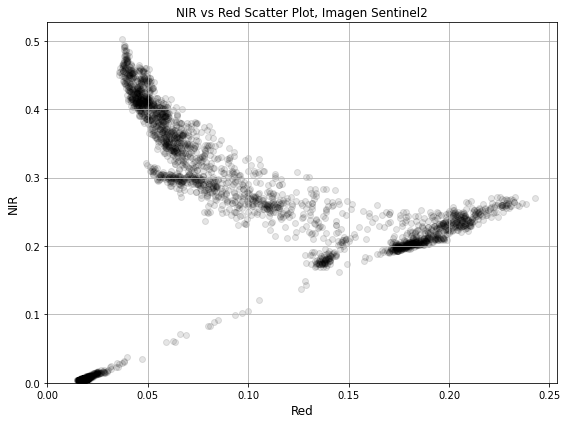

In [ ]:
# Diagrama de dispersión de la zona recortada
get_scatter_matplt(
    image=ver_imagen.clip(roi), 
    bandas=['B4','B8'], 
    multiply=1, 
    scale=10, 
    numPixels=5000,
    title="NIR vs Red Scatter Plot, Imagen Sentinel2")

In [ ]:
# @markdown **Generar de un diagrama de dispersión con Altair: `get_scatter_alt`**
# @markdown - **Nota**: Acepta un máximo de 5000 puntos.

def get_scatter_alt(
  image=None, bandas=None, multiply=None, scale=None, numPixels=None):

  # Seleccionar banda RED y NIR de L8
  samp = image.select(bandas).multiply(multiply).sample(scale=scale, 
                                                         numPixels=numPixels)

  # Organizar la muestra como una lista anidada
  samp_dict = samp.reduceColumns(ee.Reducer.toList().repeat(2), bandas)
  samp_list = ee.List(samp_dict.get("list"))

  # Guardar ee.List del lado del servidor como una lista de 
  # Python del lado del cliente
  samp_data = samp_list.getInfo()
  # samp_data[0] # 9965 valores de Reflectancia a nivel terrestre

  # Visualización con Altair y Pandas
  import pandas as pd
  dic = {'Red': samp_data[0], 
         'Nir': samp_data[1]}
  df = pd.DataFrame(dic).round(3)
  # https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.round.html

  import altair as alt
  chart = (
      alt.Chart(df)
      .mark_point()
      .encode(
          x="Red:Q",
          y="Nir:Q",
          tooltip=["Red:N", "Nir:N"],
          opacity=alt.value(0.2),
          color=alt.value("black"),
      )
      .configure_view(strokeWidth=0)
      .properties(width=500, height=400)
  ).interactive()


  # Exportar en formato html
  # chart.save('chart.png', scale_factor=2.0)

  return chart

print('get_scatter_alt(image=None, bandas=None, '+
      'multiply=None, scale=None, numPixels=None)')

get_scatter_alt(image=None, bandas=None, multiply=None, scale=None, numPixels=None)


Ajustes en la función:
- `plt.axis('square')` Para darle forma cuadrada [source](https://www.geeksforgeeks.org/how-to-make-a-square-plot-with-equal-axes-in-matplotlib/)
- https://altair-viz.github.io/user_guide/customization.html#adjusting-chart-size

In [ ]:
# Diagrama de dispersión de la zona recortada
get_scatter_alt(
    image=ver_imagen.clip(roi), 
    bandas=['B4','B8'], 
    multiply=1, 
    scale=10, 
    numPixels=5000
)

In [ ]:
# Ejemplo con imagen Sentinel2
imgS2 = ee.Image('COPERNICUS/S2_SR/20190501T151711_20190501T151806_T18LUL')
zona_estudio = ee.Geometry.Polygon([[-76.09892862983581, -13.50797160615472],
                                    [-76.09892862983581, -13.54535713639933],
                                    [-76.06768625923034, -13.54535713639933],
                                    [-76.06768625923034, -13.50797160615472]])
centroid = zona_estudio.centroid().getInfo()['coordinates']

mydicc = {'Imagen S2': imgS2.multiply(0.0001).getMapId({'min': 0.0, 'max':0.3,'bands':['B4','B3','B2']}),
          'Imagen S2 recortado': imgS2.clip(zona_estudio).multiply(0.0001).getMapId({'min': 0.0, 'max':0.3,'bands':['B4','B3','B2']}),
          'Roi': zona_estudio.getInfo()}   

mapdisplay(centroid, mydicc, Tiles='OpensTreetMap', zoom_start=14) 

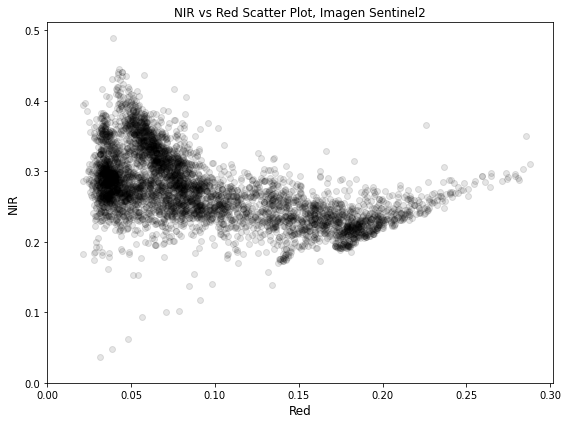

In [ ]:
# Diagrama de dispersión de la zona recortada
get_scatter_matplt(image=imgS2.clip(zona_estudio), 
                   bandas=['B4','B8'], 
                   multiply=0.0001, 
                   scale=10, 
                   numPixels=5000,
                   title="NIR vs Red Scatter Plot, Imagen Sentinel2")

In [ ]:
# Diagrama de dispersión de la zona recortada
get_scatter_alt(image=imgS2.clip(zona_estudio), 
                        bandas=['B4','B8'], 
                        multiply=0.0001, 
                        scale=10, 
                        numPixels=5000)

alt.Chart(...)

**Ejemplo con Imagen Landsat 8**

In [ ]:
# Ejemplo con imagen Landsat 8
img2 = ee.Image('LANDSAT/LC08/C01/T1_RT/LC08_006069_20190712')    
centroid = img2.geometry().centroid().getInfo()['coordinates']    

mydicc = {'Landsat8': img2.multiply(0.00001).getMapId({'min': 0.0, 'max':0.3,'bands':['B4','B3','B2']})}   

mapdisplay(centroid, mydicc, Tiles='OpensTreetMap', zoom_start=9) 

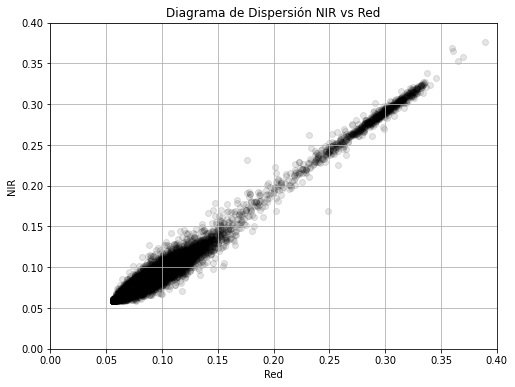

In [ ]:
# Seleccionar banda RED y NIR de L8
samp = img2.select(['B4','B8']).multiply(0.00001).sample(scale = 10, numPixels = 50000)  

# Organizar la muestra como una lista anidada
samp_dict = samp.reduceColumns(ee.Reducer.toList().repeat(2), ['B4','B8'])
samp_list = ee.List(samp_dict.get('list'))

# Guardar ee.List del lado del servidor como una lista de Python del lado del cliente
samp_data = samp_list.getInfo()
# samp_data[0] # 9965 valores de Reflectancia a nivel terrestre

# Visualización con matplotlib
import matplotlib.pyplot as plt
plt.figure(1, figsize=(8,6))
plt.scatter(samp_data[0], samp_data[1], c='black', alpha= 0.1)
plt.title('Diagrama de Dispersión NIR vs Red') #, size=15)
plt.xlabel('Red') # , fontsize = 12)
plt.ylabel('NIR'); # , fontsize = 12)
plt.xlim(0,0.4)
plt.ylim(0,0.4)
plt.grid()
# plt.tight_layout();
plt.show();

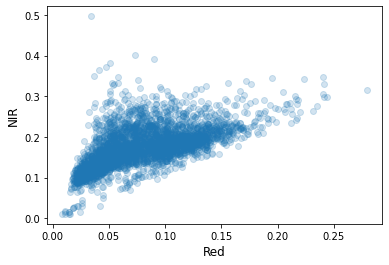

In [ ]:
# @markdown Ejemplo de Gráfica de dispersión
# Source: https://colab.research.google.com/github/google/earthengine-api/blob/master/python/examples/ipynb/ee-api-colab-setup.ipynb

# Import the matplotlib.pyplot module.
import matplotlib.pyplot as plt

# Fetch a Landsat image.
img = ee.Image('LANDSAT/LT05/C01/T1_SR/LT05_034033_20000913')

# Select Red and NIR bands, scale them, and sample 500 points. : 
# ee.Image.sample: https://developers.google.com/earth-engine/apidocs/ee-image-sample?hl=en
# img.select(['B3','B4']).divide(10000).getInfo()
samp_fc = img.select(['B3','B4']).divide(10000).sample(scale=30, numPixels=5000) # Returns: Feature collection

# Arrange the sample as a list of lists.
samp_dict = samp_fc.reduceColumns(ee.Reducer.toList().repeat(2), ['B3', 'B4'])
samp_list = ee.List(samp_dict.get('list'))

# Save server-side ee.List as a client-side Python list.
samp_data = samp_list.getInfo()

# Display a scatter plot of Red-NIR sample pairs using matplotlib.
plt.scatter(samp_data[0], samp_data[1], alpha=0.2)
plt.xlabel('Red', fontsize=12)
plt.ylabel('NIR', fontsize=12)
plt.show()

In [ ]:
# Visualización de OpenLandMap Precipitation monthly
# https://developers.google.com/earth-engine/datasets/catalog/OpenLandMap_CLM_CLM_PRECIPITATION_SM2RAIN_M_v01

# Datos Vectoriales: Amazonas
amazonas = ee.FeatureCollection('users/csaybardemo/amazonas') # ID en Asset
roi = amazonas.geometry().bounds()

rainmap = ee.Image("OpenLandMap/CLM/CLM_PRECIPITATION_SM2RAIN_M/v01").clip(roi)
#print(rainmap.bandNames().getInfo())   # Nombre de las bandas: Meses del año
rainmap_jan = rainmap.select('jan')

# Visualización
#palette_rain = ["#450155", "#3B528C", "#21918D", "#5DCA63","#FFE925"] # Palette de C. Aybar
palette_rain= ['ecffbd', 'ffff00', '3af6ff', '467aff', '313eff', '0008ff'] # Palette de dataset
center = [-78.053, -5.068]
amazonas_img = amazonas.draw(color = "000000", strokeWidth = 3, pointRadius = 3)
dict = {'January': rainmap_jan.getMapId({'min':0,'max':380,'palette':palette_rain}),'amazonas':amazonas_img.getMapId()}

#mapdisplay(center, dict, zoom_start=8)

#@markdown *Diagrama de disepersión Mes_1 vs Mes_2*

# Selección de bandas
Mes_1 = 'feb' #@param ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']
Mes_2 = 'aug' #@param ['jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec']
bands = [Mes_1,Mes_2]
# Puntos de sampleo para visualización: 3 
samp = rainmap.select(bands).sample(scale = 1000, numPixels = 10000)
#pprint(samp.getInfo()) # Visualización de la metadata (se ve mejor usando pprint: 'pretty print')

# Organizar la muestra como una lista anidada (lista dentro de una lista)
samp_dict = samp.reduceColumns(ee.Reducer.toList().repeat(2), bands)
samp_list = ee.List(samp_dict.get('list'))

# Guardar ee.List del lado del servidor como una lista de Python del lado del cliente
samp_data = samp_list.getInfo()

# Visualice un diagrama de dispersión RED vs NIR usando matplotlib
import matplotlib.pyplot as plt
plt.figure(1, figsize=(8,6))
plt.scatter(samp_data[0], samp_data[1], alpha= 0.1)
plt.title('Diagrama de Dispersión Mes_1 vs Mes_2') #, size=15)
plt.xlabel('Mes_1') #, fontsize = 12)
plt.ylabel('Mes_2') #, fontsize = 12)
;

- Para una mejor visualización de archivos JSON usar la librería **`pprint`** 
  - `from pprint import pprint`
- Devolverá los siguientes datos:
  - Properties
  - Geometry
  - Features

In [ ]:
# @markdown Sampleo en imagen: `ee.Image.sample(scale=30, numPixels=3)`
# Función de sampleo con valor de pixel de 30m : 3 puntos
samp = img2.select(['B4','B5']).sample(scale = 30, numPixels = 3)

from pprint import pprint
pprint(samp.getInfo()) 

### Visualizaciones con `plotly`

Probar:
- https://plotly.com/python/time-series/
- https://plotly.com/python/heatmaps/
- https://plotly.com/python/mapbox-county-choropleth/

### Landsat 8: Índices NDVI, EVI y NDWI

In [10]:
# Función NDVI
def get_ndvi_L8(image):
  ndvi = image.expression(
      '(nir - red) / (nir + red)',
      {'red' : image.select('B4'),
       'nir' : image.select('B5')}
       ).rename('NDVI')
  return image.addBands(ndvi)

In [9]:
# Zona de evaluación
asset_distritos = ee.FeatureCollection('users/CesarVilca/distritos')
chongoyape = asset_distritos.filterMetadata('DISTRITO','equals','CHONGOYAPE')
chongoyape_bound = chongoyape.geometry().bounds() # CAJA

In [40]:
# FILTRADO POR METADATOS: Carga imagenes Landsat 8 TOA
l8 = (
    ee.ImageCollection("LANDSAT/LC08/C01/T1_TOA")
    .filter(ee.Filter.eq('WRS_PATH', 10))
    .filter(ee.Filter.eq('WRS_ROW', 65))
    .filterDate('2021','2022')
    .filter(ee.Filter.lt('CLOUD_COVER',5))
    .sort('CLOUD_COVER')
    # .map(get_ndvi_L8)
)

# Aplicar función NDVI y recortar imagen según zona de evaluación
image_ee = l8.first()
image = get_ndvi_L8(image_ee).clip(chongoyape_bound).select('NDVI')

In [14]:
# Obtener rangos de temperatura para visualización
NDVImin = image.reduceRegion(reducer=ee.Reducer.min(), geometry=chongoyape_bound, scale=30).get('NDVI').getInfo()
NDVImax = image.reduceRegion(reducer=ee.Reducer.max(), geometry=chongoyape_bound, scale=30).get('NDVI').getInfo()
print(f'NDVI mínima de {NDVImin:.2f}')
print(f'NDVI máxima de {NDVImax:.2f}') 

NDVI mínima de -0.36
NDVI máxima de 0.81


In [45]:
# Aplicando máscaras
image_menor_0  = image.updateMask(image.lt(0))
image_interno1 = image.updateMask(image.gte(0).And(image.lt(0.1))  ) # 0 => value =< 0.1
image_interno2 = image.updateMask(image.gte(0.1).And(image.lt(0.2)) ) # 0.1 => value =< 0.2
image_interno3 = image.updateMask(image.gte(0.2).And(image.lt(0.3)) ) # 0.2 => value =< 0.3
image_interno4 = image.updateMask(image.gte(0.3).And(image.lt(0.4)) ) # 0.3 => value =< 0.4
image_interno5 = image.updateMask(image.gte(0.4).And(image.lt(0.5)) ) # 0.4 => value =< 0.5
image_interno6 = image.updateMask(image.gte(0.5).And(image.lt(0.6)) ) # 0.5 => value =< 0.6
image_interno7 = image.updateMask(image.gte(0.6).And(image.lt(0.7)) ) # 0.6 => value =< 0.7
image_interno8 = image.updateMask(image.gte(0.7).And(image.lt(0.8)) ) # 0.7 => value =< 0.8
image_externo9 = image.updateMask(image.gte(0.8))

image_interno = image.updateMask(image.gt(0).And(image.lte(0.8)))

In [49]:
# PALETA DE VISUALIZACIÓN
ndvi_palette = ["#051852", "#051852","#051852", "#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00","#429001", "#006400", "#003B00", "#000000"]
# De acuerdo al rango de colores colocar el primer valor que representa el negro a valores negativos

ndvi_palette4 = ["#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00","#429001", "#006400", "#003B00", "#000000"]
RdYIGn = ['a50026', 'e34a33', 'fca55d', 'fee99a', 'e4f49a', '9dd569', '3ba858', '006837']
vis_params = {'min':-0.4, 'max':1, 'palette': ndvi_palette}
vis_params_ndvi = {'min':0, 'max':0.8, 'palette': RdYIGn}
vis_params_rgb = {'min':0, 'max':0.3, 'bands':['B4','B3','B2']}

Map = geemap.Map(height = '700px')
Map.centerObject(image, 12)
Map.addLayer(image_ee, vis_params_rgb, 'RGB')
Map.addLayer(image, vis_params, 'NDVI')
Map.addLayer(image_menor_0, {}, 'image_menor_0')
Map.addLayer(image_interno, vis_params_ndvi, 'image_interno') # Valores de 0 a 0.8 
Map

Map(center=[-6.632225528691173, -79.47072770355791], controls=(WidgetControl(options=['position', 'transparent…

In [43]:
# PALETA DE VISUALIZACIÓN
ndvi_palette = ["#051852", "#051852","#051852", "#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00","#429001", "#006400", "#003B00", "#000000"]
# De acuerdo al rango de colores colocar el primer valor que representa el negro a valores negativos

ndvi_palette4 = ["#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00","#429001", "#006400", "#003B00", "#000000"]
vis_params = {'min':-0.4, 'max':1, 'palette': ndvi_palette}
vis_params4 = {'min':0, 'max':0.5, 'palette': ndvi_palette4}
vis_params_rgb = {'min':0, 'max':0.3, 'bands':['B4','B3','B2']}

Map = geemap.Map(height = '700px')
Map.centerObject(image, 12)
Map.addLayer(image_ee, vis_params_rgb, 'RGB')
Map.addLayer(image, vis_params, 'NDVI')
Map.addLayer(image_menor_0, {}, 'image_menor_0')
Map.addLayer(image_interno1, {'min':0, 'max':0.1, 'palette': ndvi_palette}, 'image_interno1')
Map.addLayer(image_interno2, {'min':0.1, 'max':0.2, 'palette': ndvi_palette}, 'image_interno2')
Map.addLayer(image_interno3, {'min':0.2, 'max':0.3, 'palette': ndvi_palette}, 'image_interno3')
Map.addLayer(image_interno4, {'min':0.3, 'max':0.4, 'palette': ndvi_palette}, 'image_interno4')
Map.addLayer(image_interno5, {'min':0.4, 'max':0.5, 'palette': ndvi_palette}, 'image_interno5')
Map.addLayer(image_interno6, {'min':0.5, 'max':0.6, 'palette': ndvi_palette}, 'image_interno6')
Map.addLayer(image_interno7, {'min':0.6, 'max':0.7, 'palette': ndvi_palette}, 'image_interno7')
Map.addLayer(image_interno8, {'min':0.7, 'max':0.8, 'palette': ndvi_palette}, 'image_interno8')
Map.addLayer(image_externo9, {'min':0.8, 'max':1, 'palette': ndvi_palette}, 'image_externo9')

Map

Map(center=[-6.632225528691173, -79.47072770355791], controls=(WidgetControl(options=['position', 'transparent…

In [ ]:
# Cargar imagen (en esta caso Landsat8-California)
image = ee.Image('LANDSAT/LC08/C01/T1_TOA/LC08_044034_20140318')

# Crear NDVI y NDWI
ndvi = image.normalizedDifference(['B5', 'B4'])
ndwi = image.normalizedDifference(['B5', 'B6'])

# Crear una imagen binaria usando operadores logicos. (imagen de suelo desnudo)
bare = ndvi.lt(0.2).And(ndwi.lt(0))     # Visualización de valores menores a 0.2 en ndvi y ndwi menor a 0
# .lt() = lower than
# .And() = y 
# Operadores lógicos siempre devuelven valores de ceros y unos

# Enmascarar los valores no deseados
bare = bare.updateMask(bare) # Aplicación del .updateMask(imagen con 1 y 0) borarrá los valores 0 y permanecerán los valores 1
BareId = bare.getMapId()

tiles = {"Bare": BareId}
center = [-122.3578, 37.7726]

# Display
mapdisplay(center, tiles, "Stamen Terrain")

# los valores lógicos solo displayaran ceros o unos (0 1) 
# (en blanco los valores que cumplieron la condicion donde NDVI < 0.2 y NDWI < 0)

#### Normalized Difference Vegetation Index (NDVI)

$$
\text{NDVI} = \frac{\rho_{\text{NIR}} - \rho_{\text{red}}
  }{\rho_{\text{NIR}} + \rho_{\text{red}}}
$$

In [ ]:
# Imagen Landsat 8 con el ID del mismo
img1 = ee.Image('LANDSAT/LC08/C01/T1_RT/LC08_006069_20190712')   
centro_img1 = img1.geometry().centroid().coordinates().getInfo() 

# Método 1 NDVI
# Selección de las Bandas 
nir = img1.select(['B5'])
red = img1.select(['B4'])
ndvi1 = nir.subtract(red).divide(nir.add(red))

# Método 2 NDVI
ndvi2 = img1.normalizedDifference(['B5','B4'])

# Paleta de visualización
ndvi_palette = ["#051852", "#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00","#429001", "#006400", "#003B00", "#000000"]
ndvi_viz = {'ndvi_SF':ndvi1.getMapId({'palette':ndvi_palette, 'min':0,'max':0.8}),
            'ndvi_simple':ndvi1.getMapId({'min':0,'max':0.8}),
            'ndvi_02':ndvi2.getMapId({'palette':ndvi_palette,'min':0,'max':0.8})} 
# Cuando no agregas una paleta de colores, por defecto -> Visualización monocromática

# Visualización
mapdisplay(centro_img1,ndvi_viz)

#### Enhanced Vegetation Index (EVI)

$$
\text{EVI} = 2.5 \frac{
  \rho_{\text{NIR}} - \rho_{\text{red}}}
  {\rho_{\text{NIR}} + 6\rho_{\text{red}} - 7.5\rho_{\text{blue}} + 1
  }
$$


In [ ]:
# Imagen Landsat 8 con el ID del mismo
img1 = ee.Image('LANDSAT/LC08/C01/T1_RT/LC08_006069_20190712')   
centro_img1 = img1.geometry().centroid().coordinates().getInfo()  

# EVI 
nir = img1.select(['B5'])
red = img1.select(['B4'])
blue = img1.select(['B2'])
evi1 = nir.subtract(red).multiply(2.5).divide(nir.add(red.multiply(6)).subtract(blue.multiply(7.5)).add(1))

evi2 = nir.subtract(red).divide(nir.add(red.multiply(6)).subtract(blue.multiply(7.5)).add(1)).multiply(2.5)

# VISUALIZATION
evi_palette = ["#051852", "#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00","#429001", "#006400", "#003B00", "#000000"]
evi_viz = {'ndvi_SF1':evi1.getMapId({'palette':evi_palette, 'min':0,'max':1}),
           'ndvi_SF2':evi2.getMapId({'palette':evi_palette, 'min':0,'max':1})} 
           
mapdisplay(centro_img1,evi_viz)

#### Normalized Difference Water Index (NDWI)

In [ ]:
# Imagen Landsat 8 con el ID del mismo
img1 = ee.Image('LANDSAT/LC08/C01/T1_RT/LC08_006069_20190712')   
centro_img1 = img1.geometry().centroid().coordinates().getInfo() 

# NDWI
ndwi = img1.normalizedDifference(['B5','B6'])

# Paleta de visualización
ndwi_palette = ["#000180", "#0075FD", "#6CFB93", "#F99D05", "#A70700"]
ndwi_viz = {'ndwi_SF':ndwi.getMapId({'palette':ndwi_palette, 'min':0,'max':1})}

# Visualización
mapdisplay(centro_img1,ndwi_viz)

### Sentinel 2: Índice Espectral EVI

In [ ]:
#@markdown ROI: chincha_1 (GEOJSON FILE)
chincha = {
  "type": "FeatureCollection",
  "features": [
    {
      "type": "Feature",
      "properties": {},
      "geometry": {
        "type": "Polygon",
        "coordinates": [
          [
            [
              -76.18949890136717,
              -13.318135029644719
            ],
            [
              -76.21833801269531,
              -13.38026767603707
            ],
            [
              -76.20597839355469,
              -13.439045104716296
            ],
            [
              -76.21009826660156,
              -13.47377045456579
            ],
            [
              -76.14486694335938,
              -13.48044782881521
            ],
            [
              -76.10710144042969,
              -13.47510594433495
            ],
            [
              -76.07208251953125,
              -13.479780099783259
            ],
            [
              -76.03294372558594,
              -13.460415146782308
            ],
            [
              -76.09336853027344,
              -13.375591582002007
            ],
            [
              -76.13731384277344,
              -13.332834518238672
            ],
            [
              -76.18949890136717,
              -13.318135029644719
            ]
          ]
        ]
      }
    }
  ]
}

# de GeoJSON a ee.Feature
ee_chincha = ee.Feature(chincha['features'][0])
roi = ee.FeatureCollection(ee_chincha)

# Obtenemos el centroide
centroide = ee_chincha.geometry().centroid().getInfo()['coordinates']
print('Centroid coords:',centroide)
#Vizualizamos el geo
#dicc = {'Region of interest (ROI)':ee_chincha.getInfo()}
#mapdisplay(centroide, dicc, zoom_start= 12)

In [ ]:
# Función EVI (Sentinel 2)

def evi_s2(image):
  nir  = image.select(['B8'])
  red  = image.select(['B4'])
  blue = image.select(['B2'])
  return nir.subtract(red).divide(nir.add(red.multiply(6)).subtract(blue.multiply(7.5)).add(1)).multiply(2.5).rename('EVI')

In [ ]:
#@markdown Función: ` ee_get_dates()`

#@markdown Permite obtener información de la Fecha y Hora de toma de imágen por el satélite. 

from datetime import datetime as dt
def ee_get_dates(ic):
  dates = ic.aggregate_array('system:time_start').getInfo()
  anonym = lambda x: dt.utcfromtimestamp(x/1000).strftime('%Y-%m-%d %H:%M:%S')
  return list(map(anonym, dates))
print('ee_get_dates() listo')

In [ ]:
#@markdown 1. Identificar el producto y fecha de interés disponible:

#@markdown Satellite Product: Surface Reflectance | Data Availability
#@markdown --- | ---
#@markdown Landsat 7 | 1999-01-01 – Present 
#@markdown Landsat 8 | 2013-04-01 – Present 
#@markdown Sentinel-2| 2017-03-28 – Present  

#@markdown 2. Selección del producto Sentinel
#@markdown - Sentinel-2 MSI: MultiSpectral Instrument, Level-1C:     `ee.ImageCollection("COPERNICUS/S2")`
#@markdown - Sentinel-2 MSI: MultiSpectral Instrument, Level-2A:     `ee.ImageCollection("COPERNICUS/S2_SR")`

Product_name = 'COPERNICUS/S2_SR' #@param ["COPERNICUS/S2", "COPERNICUS/S2_SR"]

#@markdown 2. Seleccionamos las fechas de interés:
Start_date = '2018-08-02'  #@param {type: "date"}
End_date  = '2020-08-04'  #@param {type: "date"}
#  Parametros globales
range_date = [Start_date, End_date]

# Llamar al ee.ImageCollection del producto Sentinel-2
# Filtro temporal (Fechas)
# Filtro espacial (La geometría: roi)
sen2_nqc = ee.ImageCollection(Product_name)\
         .filterDate(range_date[0], range_date[1])\
         .filterBounds(roi)\
         .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE',0.5))\
         .map(evi_s2)
         
# Cantidad de Imágenes
print('Total de imágenes:', sen2_nqc.size().getInfo())

# PALETA DE VISUALIZACIÓN
ndvi_palette = ["#051852", "#FFFFFF", "#C7B59B", "#A8B255", "#A3C020", "#76AD00","#429001", "#006400", "#003B00", "#000000"]
evi_palette  = ['ffffff', 'fcd163', '99b718', '66a000', '3e8601', '207401', '056201', '004c00', '011301']
dicc = {'MEDIAN_EVI_1': sen2_nqc.getMapId({'min':0,'max':1,'palette':ndvi_palette}),
        'MEDIAN_EVI_2': sen2_nqc.getMapId({'min':0,'max':1,'palette':evi_palette})}

# ploteamos los resultados!
mapdisplay(centroide, dicc, zoom_start= 13)


In [ ]:
sen2_nqc1 = ee.ImageCollection(Product_name)\
         .filterDate(range_date[0], range_date[1])\
         .filterBounds(roi)
         
print('Total de imágenes:', sen2_nqc1.size().getInfo())

sen2_nqc1_clip = sen2_nqc1.select(['B4','B3','B2']).mean().divide(10000)

mydicc = {'sennqc': sen2_nqc1_clip.getMapId({'min':0,'max':0.5,'bands':['B4','B3','B2']}),
          'Region of interest (ROI)':ee_chincha.getInfo()}

mapdisplay(centroide, mydicc,zoom_start=12)

In [ ]:
ee_get_dates(sen2_nqc)

### Philipp Gärtner - How cloudy is my ImageCollection? - QA60 band gives insights [post](https://philippgaertner.github.io/2020/08/percent-cloud-cover/)

Fuente: [Philipp Gärtner - How cloudy is my ImageCollection? - QA60 band gives insights](https://philippgaertner.github.io/2020/08/percent-cloud-cover/)

#### Prueba

In [ ]:
ee.ImageCollection('OREGONSTATE/PRISM/Norm81m').toBands().bandNames().getInfo()

In [ ]:
# Region 
area = ee.Geometry.Polygon(
        [[[-76.24907107042775, -13.28826376888911],
          [-76.24907107042775, -13.59813740313675],
          [-75.95793337511525, -13.59813740313675],
          [-75.95793337511525, -13.28826376888911]]]);

region = ee.FeatureCollection([ee.Feature(area, {'label': 'Valley region'})])

# centroide
center = area.centroid().getInfo()['coordinates']

# Visualización de nubes en imágenes S2 con la banda de calidad QA60
# 1. Generar 3 bandas: 
def addValues(image):
  cloudBitMask  = 1 << 10
  cirrusBitMask = 1 << 11
  
  cirrus    = image.bitwiseAnd(cirrusBitMask).eq(0).rename('cirrus')
  cloud     = image.bitwiseAnd(cloudBitMask).eq(0).rename('cloud')
  cloudfree = image.eq(1).rename('cloudfree')
  return image.addBands([cirrus, cloud, cloudfree])

init_date = '2019-01-01'
end_date  = '2021-01-01'

point = ee.Geometry.Point([-76.13093015688062, -13.454728969987395])

dataset = ee.ImageCollection('COPERNICUS/S2_SR')\
                  .filterBounds(point)\
                  .filterDate(init_date, end_date)\
                  .select('QA60')\
                  .map(addValues)\
                  .select(['cirrus','cloud','cloudfree']);      

# https://developers.google.com/earth-engine/guides/image_visualization#mapVisParamTable
dicc_viz1 = {'area': area.getInfo(),
             'dataset': dataset.first().getMapId({'min':0, 'max':1,'bands':['cloud', 'cirrus', 'cloudfree'],'opacity':1})}                                                  
# mapdisplay(center, dicc_viz1, zoom_start=11)     

In [ ]:
imagen = dataset.first()
imagen.bandNames().getInfo()

In [ ]:
dataset.reduceColumns(ee.Reducer.sum(), ['cirrus']).getInfo()

In [ ]:
imagen.reduceRegion(
    reducer = ee.Reducer.sum(), 
    geometry = area,
    scale = 10
    )

from pprint import pprint 
pprint(imagen.getInfo())

In [ ]:
image.reduceRegion({
  reducer: ee.Reducer.mean(),
  geometry: region.geometry(),
  scale: 30,
  maxPixels: 1e9
})

In [ ]:
imagen.reduce(ee.Reducer.sum()).getInfo()

In [ ]:
datasetReduce = dataset.reduceColumns(ee.Reducer.toList().repeat(dataset.size()),['system:index'])

In [ ]:
icol_reduced = dataset.reduce(ee.Reducer.sum())

mapdisplay(centroide, {'reduce':icol_reduced.getMapId()}, zoom_start=11)

In [ ]:
def add_date_info(df):
  df['Timestamp'] = pd.to_datetime(df['millis'], unit='ms')
  df['Year'] = pd.DatetimeIndex(df['Timestamp']).year
  df['Month'] = pd.DatetimeIndex(df['Timestamp']).month
  df['Day'] = pd.DatetimeIndex(df['Timestamp']).day
  df['DOY'] = pd.DatetimeIndex(df['Timestamp']).dayofyear
  return df

In [ ]:
# Obtener todas las fechas en milisegundos
lista_en_milis = dataset.aggregate_array('system:time_start').getInfo()

import pandas as pd

df = pd.DataFrame(lista_en_milis, columns=['millis'])
df['Nubosidad'] = dataset.aggregate_array('CLOUDY_PIXEL_PERCENTAGE').getInfo()
df = add_date_info(df)
df = df.drop(columns=['millis'])
df

# fechas.to_csv('fechas.csv')

,Nubosidad,Timestamp,Year,Month,Day,DOY
0,48.092331,2019-01-01 15:26:41.000,2019,1,1,1
1,58.199064,2019-01-06 15:26:45.000,2019,1,6,6
2,43.483208,2019-01-11 15:26:42.000,2019,1,11,11
3,37.127514,2019-01-16 15:26:46.000,2019,1,16,16
4,63.706253,2019-01-21 15:26:43.000,2019,1,21,21
...,...,...,...,...,...,...
140,27.095142,2020-12-11 15:26:43.570,2020,12,11,346
141,33.861925,2020-12-16 15:26:42.761,2020,12,16,351
142,6.746043,2020-12-21 15:26:45.709,2020,12,21,356
143,67.466670,2020-12-26 15:26:44.415,2020,12,26,361


In [ ]:
print(df.dtypes)

Fuente: [Google Earth Engine: Time Series Visualization with Altair](https://developers.google.com/earth-engine/tutorials/community/time-series-visualization-with-altair)

Visualización con [Altair: Declarative Visualization in Python](https://altair-viz.github.io/)

- [Vega Color Schemes](https://vega.github.io/vega/docs/schemes/)
- [ALGOREX: 10 Heatmaps 10 Python Libraries](https://blog.algorexhealth.com/2017/09/10-heatmaps-10-python-libraries/)

In [ ]:
# @markdown Mapa de calor (heatmap) con Altair: `vis_heatmap()`

from ipywidgets import interact, fixed

def vis_heatmap(tema, dataFrame=None):
  chart = (
      alt.Chart(dataFrame, title="Nubosidad en imágenes Sentinel2 2019")
      .mark_rect()
      .encode(
          x="Month:O",
          y="Year:O",
          color=alt.Color(
              "Nubosidad:Q",
              scale=alt.Scale(scheme=tema, domain=(0, 100))
            # scale=alt.Scale(type='linear', range=['#bfd3e6', '#6e016b'])
            ),
          tooltip=[
                   alt.Tooltip("Month:O", title="Mes"),
                   alt.Tooltip("Year:O", title="Año"),
                   alt.Tooltip("Nubosidad:Q", title="Nubosidad (%)"),
                   ],
        ).properties(width=450, height=150)
    )
  return chart

In [ ]:
# Ejemplo: https://altair-viz.github.io/gallery/weather_heatmap.html

import altair as alt

lista_temas = ['blues','tealblues','teals','greens','browns','oranges','reds','purples','warmgreys','greys',
               'viridis','magma','inferno','plasma','cividis','turbo','bluegreen','bluepurple','goldgreen','goldorange','goldred',
               'greenblue','orangered','purplebluegreen','purpleblue','purplered','redpurple','yellowgreenblue','yellowgreen','yelloworangebrown','yelloworangered']

Siendo `greenblue` el tema más apropiado.

In [ ]:
interact(vis_heatmap, tema=lista_temas, dataFrame=fixed(df));

interactive(children=(Dropdown(description='tema', options=('blues', 'tealblues', 'teals', 'greens', 'browns',…

In [ ]:
# @markdown Visualización de gráfico de barras con Altair
def vis_barras(tema, dataFrame=None):
    return (
        alt.Chart(dataFrame, title="Nubosidad en imágenes Sentinel2 2019-2020")
        .mark_bar(size=5)
        .encode(
            x="Timestamp:T",
            y="Nubosidad:Q",
            # color=alt.Color(
            #     "Nubosidad:Q", scale=alt.Scale(scheme=tema, domain=(0, 100))
            # ),
            tooltip=[
                alt.Tooltip("Timestamp:T", title="Date"),
                alt.Tooltip("Nubosidad:Q", title="Nubosidad (%)"),
            ],
        )
        .properties(width=1000, height=300)
    )

interact(vis_barras, tema=lista_temas, dataFrame=fixed(df));

interactive(children=(Dropdown(description='tema', options=('blues', 'tealblues', 'teals', 'greens', 'browns',…

In [ ]:
alt.Chart(df).mark_bar(size=3).encode(
    x='Timestamp:T',
    y='Nubosidad:Q',
    tooltip=[
        alt.Tooltip('Timestamp:T', title='Date'),
        alt.Tooltip('Nubosidad:Q', title='Nubosidad')
    ]).properties(width=800, height=400)

# https://altair-viz.github.io/user_guide/generated/core/altair.SchemeParams.html
# https://vega.github.io/vega/docs/schemes/#reference

In [ ]:
# @title Visualización de Mejores imágenes (con %) en Image Collection

init_date = '2019-01-01'
end_date  = '2021-01-01'

point = ee.Geometry.Point([-76.13093015688062, -13.454728969987395])

dataset = ee.ImageCollection('COPERNICUS/S2_SR')\
                  .filterBounds(point)\
                  .filterDate(init_date, end_date)\

# Obtener todas las fechas en milisegundos
lista_en_milis = dataset.aggregate_array('system:time_start').getInfo()

def add_date_info(df):
  df['Timestamp'] = pd.to_datetime(df['millis'], unit='ms')
  df['Year'] = pd.DatetimeIndex(df['Timestamp']).year
  df['Month'] = pd.DatetimeIndex(df['Timestamp']).month
  df['Day'] = pd.DatetimeIndex(df['Timestamp']).day
  df['DOY'] = pd.DatetimeIndex(df['Timestamp']).dayofyear
  return df

import pandas as pd
df = pd.DataFrame(lista_en_milis, columns=['millis'])
# df['Nubosidad'] = dataset.aggregate_array('CLOUDY_PIXEL_PERCENTAGE').getInfo()

import numpy as np
df['Nubosidad'] = 100-np.array(dataset.aggregate_array('CLOUDY_PIXEL_PERCENTAGE').getInfo())

df = add_date_info(df)
df = df.drop(columns=['millis'])
# display(df)
# print(df.dtypes)

import altair as alt
alt.Chart(df).mark_bar(size=3).encode(
    x='Timestamp:T',
    y='Nubosidad:Q',
    tooltip=[
        alt.Tooltip('Timestamp:T', title='Date'),
        alt.Tooltip('Nubosidad:Q', title='Nubosidad')
    ]).properties(width=800, height=400)

In [ ]:
Start_date = '2020-01-01'  #@param {type: "date"}
End_date   = '2021-01-01'  #@param {type: "date"}

img_s2 = ee.ImageCollection('COPERNICUS/S2_SR')\
        .filterDate(Start_date, End_date)\
        .filterBounds(ee.Geometry.Point(-76.13, -13.48))\

# Documentación de Earth Engine - Python API

Revisando la documentación de Earth Engine.

`.getInfo()` 

An imperative function that returns information about this image via an AJAX call.

Returns a description of the image. Includes:
  - bands - a list containing metadata about the bands in the collection.
  - properties - a dictionary containing the image's metadata properties.



In [ ]:
imagen = ee.Image('COPERNICUS/S2_SR/20190501T151711_20190501T151806_T18LUL')
imagen.getInfo().keys() # usé keys ya que sin él, se mostraría enorme el output

## `ee.Image`

Leer una imagen en EE

- `ee.Image`

In [ ]:
imagen = ee.Image('COPERNICUS/S2_SR/20190501T151711_20190501T151806_T18LUL')
imagen #OJO: con print mostrará el archivo geojson

Devolver los nombres de las bandas en una lista

- `ee.Image.bandNames()`

In [ ]:
print(imagen.bandNames().getInfo())

Obtener una propiedad de la imagen

- `ee.Image.get('property')`

In [ ]:
print(imagen.get('CLOUDY_PIXEL_PERCENTAGE').getInfo())
print(imagen.get('system:time_start').getInfo())

Devolver información de los tipos de cada banda

- `ee.Image.bandTypes()`

In [ ]:
imagen.bandTypes().getInfo()

Devolver la fecha de la toma de imagen en milisegundos (ee.Date)

- `ee.Image.date`

In [ ]:
imagen.date().getInfo() # en milisegundos

Devolver el ID de la imagen en string

- `ee.Image.id` : Returns the ID of a given element within a collection. Objects outside collections are not guaranteed to have IDs.



In [ ]:
imagen.id().getInfo() # Returns: string

Devolver una lista con los nombres de las propiedades 

- `ee.Image.propertyNames`

In [ ]:
imagen.propertyNames().getInfo() # Returns: list

Seleccionar una banda / bandas

- `ee.Image.select` : Selects bands from an image.


In [ ]:
imagen.select(['B4']).bandNames().getInfo()

Renombrar una banda (Usado cuando se crean nuevas bandas)

- `ee.Image.rename` : Rename the bands of an image. 

Recortar una imagen

- `ee.Image.clip` : Clips an image to a Geometry or Feature. `Image.clip(geometry)`
- `ee.Image.clipToCollection` : Clips an image to a FeatureCollection. `Image.clipToCollection(collection)`

Diferencia normalizada con dos bandas

- `ee.Image.normalizedDifference` : Computes the normalized difference between two bands. 
  -  `ee.Image.normalizedDifference(['B4','B8'])`

### Operaciones con `ee.Image`

#### Asignar valores a imágenes

- `ee.Image.constant`

In [ ]:
constante2 = ee.Image.constant(2)
constante3 = ee.Image.constant(3)
constante4 = ee.Image.constant(4)

- `ee.Image.double` : Casts the input value to a 64-bit float.



In [ ]:
ee.Image.double(1.23412412).getInfo() # OJO: no muestra el valor

- `ee.Image.float` : Casts the input value to a 32-bit float.

In [ ]:
ee.Image.float(1.236464).getInfo()

- `ee.Image.int = ee.Image.int32` : Casts the input value to a signed 32-bit integer.

- y así para: `int16, int64, int8`

#### Operadores matemáticos


- `ee.Image.add`
- `ee.Image.subtract`
- `ee.Image.multiply`
- `ee.Image.divide`
- `ee.Image.pow`
- `ee.Image.sqrt`

In [ ]:
print(constante2.add(constante3).add(constante4).getInfo())
print(constante2.subtract(constante3).subtract(constante4).getInfo())
print(constante2.multiply(constante3).multiply(constante4).getInfo())
print(constante2.divide(constante3).divide(constante4).getInfo())

- `ee.Image.log` : Computes the natural logarithm of the input.
- `ee.Image.log10` : Computes the base-10 logarithm of the input.

In [ ]:
ee.Image.log10(100).getInfo() # Returns: image

- Trigonometría

  - `ee.Image.sin`
  - `ee.Image.cos`
  - `ee.Image.tan`

- Con hiperbólico agregar un `h` al final: `ee.Image.sinh`
- Para arcos agregar una `a` al inicio: `ee.Image.asin`


#### Uso de Condicionales Lógicos

- `ee.Image.eq` : equal 
- `ee.Image.neq` : no equal
- `ee.Image.lt` : lower than
- `ee.Image.gt` : greater than 

#### Operaciones de bits

- `ee.Image.bitwiseAnd`
- `ee.Image.bitwiseNot`
- `ee.Image.bitwiseOr`
- `ee.Image.bitwiseXor`
- `ee.Image.bitwise_and`
- `ee.Image.bitwise_not`
- `ee.Image.bitwise_or`
- `ee.Image.bitwise_xor`

### Falta comentar

- `ee.Image.addBands` (agregar bandas a una imagen existente)
- `ee.Image.classify` (clasificación supervisada)
- `ee.Image.expression` (para fórmulas)
- `ee.Image.toArray` (y todos sus módulos),  `ee.Image.getArray`
- `ee.Image.getMapId` (visualización)
- `ee.Image.min` y `ee.Image.max`
- `ee.Image.reduce` (y todas la familia de reductores)
- `ee.Image.sample` (tomar una muestra de una imagen)
- `ee.Image.set`
- `ee.Image.mask` y `ee.Image.updateMask`


## `ee.ImageCollection`

ImageCollections can be constructed from the following arguments:
  - A string: assumed to be the name of a collection,
  - A list of images, or anything that can be used to construct an image.
  - A single image.
  - A computed object - reinterpreted as a collection.

In [ ]:
point = ee.Geometry.Point([-76.13093015688062, -13.454728969987395])

dataset = ee.ImageCollection('COPERNICUS/S2_SR')\
                  .filterBounds(point)\
                  .filterDate('2020-01-01','2020-02-01')

- `ee.ImageCollection.aggregate_`

In [ ]:
# Aggregates over a given property of the objects in a collection, calculating a list of all the values of the selected property.
dataset.aggregate_array('system:time_start').getInfo()

# Aggregates over a given property of the objects in a collection, calculating the number of non-null values of the property.
dataset.aggregate_count('system:time_start').getInfo()

# Aggregates over a given property of the objects in a collection, calculating the property value of the first object in the collection.
dataset.aggregate_first('system:time_start').getInfo()

# Aggregates over a given property of the objects in a collection, calculating a histogram of the selected property.
dataset.aggregate_histogram('system:time_start').getInfo()

# Aggregates over a given property of the objects in a collection, calculating the maximum of the values of the selected property.
dataset.aggregate_max('system:time_start').getInfo()
dataset.aggregate_mean('system:time_start').getInfo()
dataset.aggregate_min('system:time_start').getInfo()

# Aggregates over a given property of the objects in a collection, calculating: 
# sum, min, max, mean, sample standard deviation, sample variance, total standard deviation and total variance of the selected property.
dataset.aggregate_stats('system:time_start').getInfo()

# Aggregates over a given property of the objects in a collection, calculating the sum of the values of the selected property.
dataset.aggregate_sum('system:time_start').getInfo() # SUMA 

# Aggregates over a given property of the objects in a collection, calculating the total std. deviation of the values of the selected property.
dataset.aggregate_total_sd('system:time_start').getInfo()

# Aggregates over a given property of the objects in a collection, calculating the total variance of the values of the selected property.
dataset.aggregate_total_var('system:time_start').getInfo() 

In [ ]:
dataset.copyProperties
dataset.count().getInfo()
dataset.draw().getInfo()

- `ee.ImageCollection.filter`
- `ee.ImageCollection.filterBounds`
- `ee.ImageCollection.filterDate`
- `ee.ImageCollection.filterMetadata`

In [ ]:
dataset = ee.ImageCollection('COPERNICUS/S2_SR')\
                  .filterBounds(point)\
                  .filterDate('2020-01-01','2020-02-01')

img_col = ee.ImageCollection("LANDSAT/LC08/C01/T1_SR")\
        .filterDate(Start_date, End_date)\
        .filterBounds(ee.Geometry.Point(-76.13, -13.48))\
        .sort('CLOUD_COVER')#\.first()

- `ee.ImageCollection.copyProperties`
- `ee.ImageCollection.count`

- `ee.ImageCollection.first`
- `ee.ImageCollection.map`
- `ee.ImageCollection.merge`
- `ee.ImageCollection.reduce`
- `ee.ImageCollection.reduceColumns`
- `ee.ImageCollection.select`
- `ee.ImageCollection.size`
- `ee.ImageCollection.set`
- `ee.ImageCollection.sort`
- `ee.ImageCollection.toArray`
- `ee.ImageCollection.toBands`
- `ee.ImageCollection.toDictionary`
- `ee.ImageCollection.toList`

## `ee.Feature`


https://developers.google.com/earth-engine/apidocs/ee-feature

`ee.Feature(geometry, properties)`

In [ ]:
# Crear feature de tipo punto
Bosque = ee.Feature(ee.Geometry.Point(-62.709, -31.428), {"Cobertura": "Bosque", "Valor": 1})
Agua = ee.Feature(ee.Geometry.Point(-61.248, -31.475), {"Cobertura": "Agua", "Valor": 2})
Suelo = ee.Feature(ee.Geometry.Point(-61.765, -31.840), {"Cobertura": "Suelo", "Valor": 3})
Agricultura = ee.Feature(ee.Geometry.Point(-62.534, -31.858), {"Cobertura": "Agricultura", "Valor": 4})

# Composicion de features
features = [Bosque, Agua, Suelo, Agricultura]

# Crear un featureCollection
Cobertura = ee.FeatureCollection(features)
Cobertura.getInfo()

{'columns': {'Cobertura': 'String',
  'Valor': 'Integer',
  'system:index': 'String'},
 'features': [{'geometry': {'coordinates': [-62.709, -31.428],
    'type': 'Point'},
   'id': '0',
   'properties': {'Cobertura': 'Bosque', 'Valor': 1},
   'type': 'Feature'},
  {'geometry': {'coordinates': [-61.248, -31.475], 'type': 'Point'},
   'id': '1',
   'properties': {'Cobertura': 'Agua', 'Valor': 2},
   'type': 'Feature'},
  {'geometry': {'coordinates': [-61.765, -31.84], 'type': 'Point'},
   'id': '2',
   'properties': {'Cobertura': 'Suelo', 'Valor': 3},
   'type': 'Feature'},
  {'geometry': {'coordinates': [-62.534, -31.858], 'type': 'Point'},
   'id': '3',
   'properties': {'Cobertura': 'Agricultura', 'Valor': 4},
   'type': 'Feature'}],
 'type': 'FeatureCollection'}

In [ ]:
centroide_fc = Cobertura.geometry().centroid().coordinates().getInfo()

In [ ]:
vis = {'Puntos': Cobertura.getMapId()}

mapdisplay(centroide_fc, vis, zoom_start=8)

## `ee.FeatureCollection`
## `ee.Geometry`


## `ee.Date`


In [ ]:
# conv_fecha ----------------------------------------
def conv_fecha(img, exact=None):
  '''
  Obtener fecha con formato YYYY-MM-dd H:mm:ss
  img: ee.Image
  '''
  if exact==True:
    return img.date().format('YYYY-MM-dd').getInfo()
  else:
    return img.date().format('YYYY-MM-dd H:mm:ss').getInfo()
print('conv_fecha(img, getInfo=None) listo!')

In [ ]:
# @markdown **Prueba**: Visualización de imágenes Landsat con menor nubosidad para el ROI

# @markdown Seleccionamos las fechas de inicio y fin para el filtrado

# Inputs
Start_date = '2020-01-01'  #@param {type: "date"}
End_date   = '2021-01-01'  #@param {type: "date"}

## Filtrado de imágenes
# 1er Filtrado: Obteniendo la fecha con menor nubosidad en imagen
img_col = ee.ImageCollection("LANDSAT/LC08/C01/T1_SR")\
            .filterDate(Start_date, End_date)\
            .filterBounds(roiDep)\
            .sort('CLOUD_COVER')
            
mejor_fecha = img_col.first().date().getInfo()['value']
fecha1 = ee.Date(mejor_fecha)
fecha2 = fecha1.advance(16, 'day') # ee.Date().advance()

# Metadatos
print('--- Metadatos del Image Collection img_col ---')
ver_rangos(img_col)
print(f"Fecha de mejor toma: {ee.Date(mejor_fecha).format('YYYY-MM-dd').getInfo()}")

# 2do Fitrado: Visualización de imágenes con mejor toma
img_col = ee.ImageCollection("LANDSAT/LC08/C01/T1_SR")\
            .filterDate(fecha1, fecha2)\
            .filterBounds(roiDep)\
            .sort('CLOUD_COVER')

imagenes = img_col.median().multiply(0.0001).select(['B4','B3','B2'])

# Visualizacion
chongoyape = ee.Geometry.Point([-79.389, -6.639])
oyotun     = ee.Geometry.Point([-79.309, -6.846])
centroide  = ee.Geometry.Point([-79.823, -6.351])

dict_img = {
    'img_col': imagenes.getMapId({
        'min':0.0, 'max':0.3, 'bands': ['B4','B3','B2']}),
    'Lambayeque_shp': roiDepDraw.getMapId(),
    'Chongoyape': chongoyape.getInfo(),
    'Centroide': centroide.getInfo(),
    'Oyotun': oyotun.getInfo()
    } # ,'roi': roi_clip.getInfo()

mapdisplay(centroidDep, dict_img, zoom_start=8)

## `ee.Filter`
## `ee.Reducer`

## `ee.DateRange`

<center>
<p>
&lt; 
<a href="https://colab.research.google.com/drive/1FPZupdZISJmzS_ZNJEUv6eMGV3hxlzOu?authuser=1">Snippets_Colab</a> 
|
<a href="https://colab.research.google.com/drive/1FTTWqFgdLzdGD3GEHOBezUJz1LcpxJE3">Snippets_geemap</a>  
|
<a href="https://colab.research.google.com/drive/1ITWgnSyNsfrpvp3q4GtKZwi0oInQfIYi">Snippets_Pandas</a>  
|
Snippets_GEE
|
<a href="https://colab.research.google.com/drive/1KXRY7_A430ZjUwlXKVTjDq8__PsOt9uU?authuser=1">Snippets_Python</a> 
&gt;
</p>
</center>

## Código removido

In [ ]:
# @markdown *Visualización2 de un archivo vectorial (Dptos del Perú)*

# @markdown - Filtrado de `FeatureCollection` y visualización con `.draw`

# ----- Visualización mediante ID en Asset -----

# Todo el Perú con sus 24 departamentos
shpPeru = ee.FeatureCollection('users/CesarVilca/Departamentos_Peru')

# Filtrado: Solo un departamento
shpDep = ee.FeatureCollection('users/CesarVilca/Departamentos_Peru').filter(
    ee.Filter.eq('NOMBDEP', 'LAMBAYEQUE'))

roiPeru = shpPeru.geometry()
roiDep  = shpDep.geometry()

# Centrado de la visualización
centroidPeru = roiPeru.centroid().coordinates().getInfo()   
centroidDep  = roiDep.centroid().coordinates().getInfo()   

# https://htmlcolors.com/ para modificar el color
roiPeruDraw = shpPeru.draw(color = "000000", strokeWidth = 2, pointRadius = 2) 
roiDepDraw  = shpDep.draw(color = "29B6F6", strokeWidth = 2, pointRadius = 2) 

dicc_viz1 = {
    'Perú': roiPeruDraw.getMapId(),
    'Lambayeque': roiDepDraw.getMapId()
    }  
# [-69,-13]
mapdisplay(centroidPeru, dicc_viz1, zoom_start=6)

In [ ]:
# @markdown *Visualización2 de un archivo vectorial (Cuencas - Angel Ticona)*

# @markdown Filtrado de `FeatureCollection` y visualización con `.draw`

# ----- Visualización mediante ID en Asset -----

# Todo el Perú con sus 24 departamentos
shpPeru = ee.FeatureCollection('users/sigyury/CHIRILU_Subcuencas').filter(
    ee.Filter.eq('ID_CH', 1089))

# Filtrado: Solo un departamento
shpDep = ee.FeatureCollection('users/CesarVilca/Departamentos_Peru').filter(
    ee.Filter.eq('NOMBDEP', 'LAMBAYEQUE'))

roiPeru = shpPeru.geometry()
roiDep  = shpDep.geometry()

# Centrado de la visualización
centroidPeru = roiPeru.centroid().coordinates().getInfo()   
centroidDep  = roiDep.centroid().coordinates().getInfo()   

# https://htmlcolors.com/ para modificar el color
roiPeruDraw = shpPeru.draw(color = "000000", strokeWidth = 2, pointRadius = 2) 
roiDepDraw  = shpDep.draw(color = "29B6F6", strokeWidth = 2, pointRadius = 2) 

dicc_viz1 = {
    'Perú': roiPeruDraw.getMapId(),
    # 'Lambayeque': roiDepDraw.getMapId()
    }  
# [-69,-13]
mapdisplay(centroidPeru, dicc_viz1, zoom_start=9)

> [Don't use a complex collection as the region for a reducer](https://developers.google.com/earth-engine/guides/best_practices#if-you-need-to-clip-with-a-complex-collection,-use-cliptocollection)
If you really need to clip something, and the geometries you want to use for clipping are in a collection, use clipToCollection(). \\
Do NOT use featureCollection.geometry() or featureCollection.union() on large and/or complex collections, which can be more memory intensive. 